In [11]:
import logging

import scanpy as sc
import numpy as np
import pandas as pd
import scipy
import anndata
import squidpy as sq
import matplotlib.pyplot as plt
import tifffile
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import KMeans
from gensim.corpora import Dictionary
from gensim.models import LdaModel
from umap import UMAP

In [12]:
from mgitools.os_helpers import listfiles

In [13]:
%load_ext autoreload

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [14]:
%autoreload 2

In [15]:
from mip.gating import get_ideal_window

In [3]:
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.DEBUG)

In [4]:
fps = sorted(listfiles('/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/', regex=r'cell_annotation_full.h5ad$'))
fps

['/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT206B1-H1/level_4/cell_annotation_full.h5ad',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT323B1-H1A1/level_4/cell_annotation_full.h5ad',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT323B1-H1A4/level_4/cell_annotation_full.h5ad',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT323B1-H3/level_4/cell_annotation_full.h5ad',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT339B1-H1A1/level_4/cell_annotation_full.h5ad',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT339B1-H2A1/level_4/cell_annotation_full.h5ad',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT339B1-H4A4/level_4/cell_annotation_full.h5ad',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT397B1-H2A2/level_4/cell_annotation_full.h5ad',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT397B1-H3A1/level_4/cell_annotation_full.h5ad']

In [5]:
def cell_to_neighbors(adata, radius=50):
    X = adata.obs[['centroid_row', 'centroid_col']].values
    nbrs = NearestNeighbors(algorithm='ball_tree').fit(X)
    
    g = nbrs.radius_neighbors_graph(X, radius=radius)
    rows, cols, _ = scipy.sparse.find(g)
    
    cell_to_neighbhors = {}
    for r, c in zip(rows, cols):
        cid = adata.obs.index[r]
        if cid not in cell_to_neighbhors:
            cell_to_neighbhors[cid] = []
        else:
            cell_to_neighbhors[cid].append(adata.obs.index[c])
            
    return cell_to_neighbhors



In [6]:
sample_to_adata = {}
cell_to_nbhrs = {}
for fp in fps:
    sample = fp.split('/')[-3]
    a = sc.read_h5ad(fp)
    print(sample, a.shape)
    
    a.obs['sample_id'] = sample
    a.obs.index = [f'{sample}_{x}' for x in a.obs.index.to_list()]
    cell_to_nbhrs.update(cell_to_neighbors(a, radius=50))
    sample_to_adata[sample] = a

2022-05-26 07:02:17,940 : DEBUG : Creating converter from 3 to 5


In [26]:
fps = sorted(listfiles('/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/', regex=r'pseudo.tiff$'))
fps

['/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT206B1-H1/level_2/pseudo.tiff',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT323B1-H1A1/level_2/pseudo.tiff',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT323B1-H1A4/level_2/pseudo.tiff',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT323B1-H3/level_2/pseudo.tiff',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT339B1-H1A1/level_2/pseudo.tiff',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT339B1-H2A1/level_2/pseudo.tiff',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT339B1-H4A4/level_2/pseudo.tiff',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT397B1-H2A2/level_2/pseudo.tiff',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT397B1-H3A1/level_2/pseudo.tiff']

In [27]:
sample_to_pseudo = {fp.split('/')[-3]:tifffile.imread(fp) for fp in fps}

In [7]:
sample_to_adata.keys()

dict_keys(['HT206B1-H1', 'HT323B1-H1A1', 'HT323B1-H1A4', 'HT323B1-H3', 'HT339B1-H1A1', 'HT339B1-H2A1', 'HT339B1-H4A4', 'HT397B1-H2A2', 'HT397B1-H3A1'])

In [13]:
cells = []
docs = []
for s, a in sample_to_adata.items():
    cell_to_cell_type = {c:ct for c, ct in zip(a.obs.index, a.obs['cell_type'])}
    docs += [[cell_to_cell_type[neighbor] for neighbor in cell_to_nbhrs[cell_id]]
            for cell_id in a.obs.index.to_list()]
    print(s, len(docs))
    cells += a.obs.index.to_list()

HT206B1-H1 221081
HT323B1-H1A1 306433
HT323B1-H1A4 446558
HT323B1-H3 715253
HT339B1-H1A1 753856
HT339B1-H2A1 837961
HT339B1-H4A4 857394
HT397B1-H2A2 1009774
HT397B1-H3A1 1255570


In [14]:
dictionary = Dictionary(docs)
corpus = [dictionary.doc2bow(doc) for doc in docs]

2022-05-26 07:11:38,151 : INFO : adding document #0 to Dictionary<0 unique tokens: []>
2022-05-26 07:11:38,286 : INFO : adding document #10000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:38,380 : INFO : adding document #20000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:38,461 : INFO : adding document #30000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:38,535 : INFO : adding document #40000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:38,607 : INFO : adding document #50000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:38,678 : INFO : adding document #60000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrop

2022-05-26 07:11:42,258 : INFO : adding document #540000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:42,340 : INFO : adding document #550000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:42,423 : INFO : adding document #560000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:42,502 : INFO : adding document #570000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:42,583 : INFO : adding document #580000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:42,664 : INFO : adding document #590000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:42,744 : INFO : adding document #600000 to Dictionary

2022-05-26 07:11:46,073 : INFO : adding document #1070000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:46,140 : INFO : adding document #1080000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:46,205 : INFO : adding document #1090000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:46,269 : INFO : adding document #1100000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:46,335 : INFO : adding document #1110000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:46,407 : INFO : adding document #1120000 to Dictionary<10 unique tokens: ['Epithelial', 'Other', 'B_cell', 'Fibroblast', 'Macrophage']...>
2022-05-26 07:11:46,480 : INFO : adding document #1130000 to Dic

In [15]:
len(dictionary), len(corpus), len(cells)

(10, 1255570, 1255570)

In [16]:
num_topics = 10
chunksize = len(corpus)
passes = 2
iterations = 100
eval_every = 10 # turn this on to see how well everything is converging. off by default bc is takes time

In [17]:
temp = dictionary[0]
id2word = dictionary.id2token

model = LdaModel(
    corpus=corpus,
    id2word=id2word,
    chunksize=chunksize,
    alpha='auto',
    eta='auto',
    iterations=iterations,
    num_topics=num_topics,
    passes=passes,
    eval_every=eval_every
)

2022-05-26 07:13:19,866 : INFO : using autotuned alpha, starting with [0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1]
2022-05-26 07:13:19,868 : INFO : using serial LDA version on this node
2022-05-26 07:13:19,911 : INFO : running online (multi-pass) LDA training, 10 topics, 5 passes over the supplied corpus of 1255570 documents, updating model once every 1255570 documents, evaluating perplexity every 1255570 documents, iterating 100x with a convergence threshold of 0.001000
2022-05-26 07:13:19,912 : WARNING : too few updates, training might not converge; consider increasing the number of passes or iterations to improve accuracy
2022-05-26 07:13:20,215 : DEBUG : bound: at document #0
2022-05-26 07:20:43,251 : INFO : -3.023 per-word bound, 8.1 perplexity estimate based on a held-out corpus of 1255570 documents with 13474848 words
2022-05-26 07:20:43,254 : INFO : PROGRESS: pass 0, at document #1255570/1255570
2022-05-26 07:20:43,255 : DEBUG : performing inference on a chunk of 1255570 

2022-05-26 07:55:41,747 : INFO : topic #8 (0.151): 0.945*"Epithelial" + 0.025*"Fibroblast" + 0.009*"Myoepithelial" + 0.009*"Other" + 0.004*"CD8_T_cell" + 0.003*"CD4_T_cell" + 0.003*"Endothelial" + 0.002*"Macrophage" + 0.001*"DC" + 0.000*"B_cell"
2022-05-26 07:55:41,747 : INFO : topic diff=0.237213, rho=0.447214
2022-05-26 07:55:42,175 : DEBUG : bound: at document #0
2022-05-26 08:00:50,005 : INFO : -1.385 per-word bound, 2.6 perplexity estimate based on a held-out corpus of 1255570 documents with 13474848 words
2022-05-26 08:00:50,008 : INFO : PROGRESS: pass 4, at document #1255570/1255570
2022-05-26 08:00:50,009 : DEBUG : performing inference on a chunk of 1255570 documents
2022-05-26 08:04:48,039 : DEBUG : 1249804/1255570 documents converged within 100 iterations
2022-05-26 08:04:51,029 : INFO : optimized alpha [0.07103746, 0.084263265, 0.05368688, 0.061893627, 0.06530512, 0.066595815, 0.05648874, 0.06258509, 0.16270217, 0.05826092]
2022-05-26 08:04:51,030 : DEBUG : updating topics
2

In [18]:
top_topics = model.top_topics(corpus)
avg_topic_coherence = sum([t[1] for t in top_topics]) / num_topics

2022-05-26 08:05:14,104 : DEBUG : Setting topics to those of the model: LdaModel<num_terms=10, num_topics=10, decay=0.5, chunksize=1255570>
2022-05-26 08:05:14,116 : INFO : CorpusAccumulator accumulated stats from 1000 documents
2022-05-26 08:05:14,122 : INFO : CorpusAccumulator accumulated stats from 2000 documents
2022-05-26 08:05:14,129 : INFO : CorpusAccumulator accumulated stats from 3000 documents
2022-05-26 08:05:14,136 : INFO : CorpusAccumulator accumulated stats from 4000 documents
2022-05-26 08:05:14,142 : INFO : CorpusAccumulator accumulated stats from 5000 documents
2022-05-26 08:05:14,147 : INFO : CorpusAccumulator accumulated stats from 6000 documents
2022-05-26 08:05:14,154 : INFO : CorpusAccumulator accumulated stats from 7000 documents
2022-05-26 08:05:14,159 : INFO : CorpusAccumulator accumulated stats from 8000 documents
2022-05-26 08:05:14,165 : INFO : CorpusAccumulator accumulated stats from 9000 documents
2022-05-26 08:05:14,171 : INFO : CorpusAccumulator accumula

2022-05-26 08:05:14,476 : INFO : CorpusAccumulator accumulated stats from 91000 documents
2022-05-26 08:05:14,479 : INFO : CorpusAccumulator accumulated stats from 92000 documents
2022-05-26 08:05:14,482 : INFO : CorpusAccumulator accumulated stats from 93000 documents
2022-05-26 08:05:14,485 : INFO : CorpusAccumulator accumulated stats from 94000 documents
2022-05-26 08:05:14,488 : INFO : CorpusAccumulator accumulated stats from 95000 documents
2022-05-26 08:05:14,491 : INFO : CorpusAccumulator accumulated stats from 96000 documents
2022-05-26 08:05:14,494 : INFO : CorpusAccumulator accumulated stats from 97000 documents
2022-05-26 08:05:14,497 : INFO : CorpusAccumulator accumulated stats from 98000 documents
2022-05-26 08:05:14,501 : INFO : CorpusAccumulator accumulated stats from 99000 documents
2022-05-26 08:05:14,504 : INFO : CorpusAccumulator accumulated stats from 100000 documents
2022-05-26 08:05:14,507 : INFO : CorpusAccumulator accumulated stats from 101000 documents
2022-05-

2022-05-26 08:05:14,745 : INFO : CorpusAccumulator accumulated stats from 182000 documents
2022-05-26 08:05:14,748 : INFO : CorpusAccumulator accumulated stats from 183000 documents
2022-05-26 08:05:14,751 : INFO : CorpusAccumulator accumulated stats from 184000 documents
2022-05-26 08:05:14,754 : INFO : CorpusAccumulator accumulated stats from 185000 documents
2022-05-26 08:05:14,757 : INFO : CorpusAccumulator accumulated stats from 186000 documents
2022-05-26 08:05:14,759 : INFO : CorpusAccumulator accumulated stats from 187000 documents
2022-05-26 08:05:14,763 : INFO : CorpusAccumulator accumulated stats from 188000 documents
2022-05-26 08:05:14,765 : INFO : CorpusAccumulator accumulated stats from 189000 documents
2022-05-26 08:05:14,769 : INFO : CorpusAccumulator accumulated stats from 190000 documents
2022-05-26 08:05:14,772 : INFO : CorpusAccumulator accumulated stats from 191000 documents
2022-05-26 08:05:14,775 : INFO : CorpusAccumulator accumulated stats from 192000 documents

2022-05-26 08:05:15,066 : INFO : CorpusAccumulator accumulated stats from 273000 documents
2022-05-26 08:05:15,069 : INFO : CorpusAccumulator accumulated stats from 274000 documents
2022-05-26 08:05:15,072 : INFO : CorpusAccumulator accumulated stats from 275000 documents
2022-05-26 08:05:15,076 : INFO : CorpusAccumulator accumulated stats from 276000 documents
2022-05-26 08:05:15,079 : INFO : CorpusAccumulator accumulated stats from 277000 documents
2022-05-26 08:05:15,083 : INFO : CorpusAccumulator accumulated stats from 278000 documents
2022-05-26 08:05:15,086 : INFO : CorpusAccumulator accumulated stats from 279000 documents
2022-05-26 08:05:15,089 : INFO : CorpusAccumulator accumulated stats from 280000 documents
2022-05-26 08:05:15,092 : INFO : CorpusAccumulator accumulated stats from 281000 documents
2022-05-26 08:05:15,096 : INFO : CorpusAccumulator accumulated stats from 282000 documents
2022-05-26 08:05:15,099 : INFO : CorpusAccumulator accumulated stats from 283000 documents

2022-05-26 08:05:15,380 : INFO : CorpusAccumulator accumulated stats from 364000 documents
2022-05-26 08:05:15,384 : INFO : CorpusAccumulator accumulated stats from 365000 documents
2022-05-26 08:05:15,387 : INFO : CorpusAccumulator accumulated stats from 366000 documents
2022-05-26 08:05:15,391 : INFO : CorpusAccumulator accumulated stats from 367000 documents
2022-05-26 08:05:15,394 : INFO : CorpusAccumulator accumulated stats from 368000 documents
2022-05-26 08:05:15,398 : INFO : CorpusAccumulator accumulated stats from 369000 documents
2022-05-26 08:05:15,401 : INFO : CorpusAccumulator accumulated stats from 370000 documents
2022-05-26 08:05:15,404 : INFO : CorpusAccumulator accumulated stats from 371000 documents
2022-05-26 08:05:15,408 : INFO : CorpusAccumulator accumulated stats from 372000 documents
2022-05-26 08:05:15,411 : INFO : CorpusAccumulator accumulated stats from 373000 documents
2022-05-26 08:05:15,415 : INFO : CorpusAccumulator accumulated stats from 374000 documents

2022-05-26 08:05:15,707 : INFO : CorpusAccumulator accumulated stats from 455000 documents
2022-05-26 08:05:15,711 : INFO : CorpusAccumulator accumulated stats from 456000 documents
2022-05-26 08:05:15,714 : INFO : CorpusAccumulator accumulated stats from 457000 documents
2022-05-26 08:05:15,718 : INFO : CorpusAccumulator accumulated stats from 458000 documents
2022-05-26 08:05:15,722 : INFO : CorpusAccumulator accumulated stats from 459000 documents
2022-05-26 08:05:15,726 : INFO : CorpusAccumulator accumulated stats from 460000 documents
2022-05-26 08:05:15,730 : INFO : CorpusAccumulator accumulated stats from 461000 documents
2022-05-26 08:05:15,734 : INFO : CorpusAccumulator accumulated stats from 462000 documents
2022-05-26 08:05:15,737 : INFO : CorpusAccumulator accumulated stats from 463000 documents
2022-05-26 08:05:15,741 : INFO : CorpusAccumulator accumulated stats from 464000 documents
2022-05-26 08:05:15,745 : INFO : CorpusAccumulator accumulated stats from 465000 documents

2022-05-26 08:05:16,075 : INFO : CorpusAccumulator accumulated stats from 546000 documents
2022-05-26 08:05:16,078 : INFO : CorpusAccumulator accumulated stats from 547000 documents
2022-05-26 08:05:16,082 : INFO : CorpusAccumulator accumulated stats from 548000 documents
2022-05-26 08:05:16,085 : INFO : CorpusAccumulator accumulated stats from 549000 documents
2022-05-26 08:05:16,089 : INFO : CorpusAccumulator accumulated stats from 550000 documents
2022-05-26 08:05:16,093 : INFO : CorpusAccumulator accumulated stats from 551000 documents
2022-05-26 08:05:16,096 : INFO : CorpusAccumulator accumulated stats from 552000 documents
2022-05-26 08:05:16,100 : INFO : CorpusAccumulator accumulated stats from 553000 documents
2022-05-26 08:05:16,103 : INFO : CorpusAccumulator accumulated stats from 554000 documents
2022-05-26 08:05:16,107 : INFO : CorpusAccumulator accumulated stats from 555000 documents
2022-05-26 08:05:16,111 : INFO : CorpusAccumulator accumulated stats from 556000 documents

2022-05-26 08:05:16,436 : INFO : CorpusAccumulator accumulated stats from 637000 documents
2022-05-26 08:05:16,439 : INFO : CorpusAccumulator accumulated stats from 638000 documents
2022-05-26 08:05:16,443 : INFO : CorpusAccumulator accumulated stats from 639000 documents
2022-05-26 08:05:16,447 : INFO : CorpusAccumulator accumulated stats from 640000 documents
2022-05-26 08:05:16,450 : INFO : CorpusAccumulator accumulated stats from 641000 documents
2022-05-26 08:05:16,454 : INFO : CorpusAccumulator accumulated stats from 642000 documents
2022-05-26 08:05:16,458 : INFO : CorpusAccumulator accumulated stats from 643000 documents
2022-05-26 08:05:16,461 : INFO : CorpusAccumulator accumulated stats from 644000 documents
2022-05-26 08:05:16,465 : INFO : CorpusAccumulator accumulated stats from 645000 documents
2022-05-26 08:05:16,471 : INFO : CorpusAccumulator accumulated stats from 646000 documents
2022-05-26 08:05:16,475 : INFO : CorpusAccumulator accumulated stats from 647000 documents

2022-05-26 08:05:16,758 : INFO : CorpusAccumulator accumulated stats from 728000 documents
2022-05-26 08:05:16,761 : INFO : CorpusAccumulator accumulated stats from 729000 documents
2022-05-26 08:05:16,764 : INFO : CorpusAccumulator accumulated stats from 730000 documents
2022-05-26 08:05:16,767 : INFO : CorpusAccumulator accumulated stats from 731000 documents
2022-05-26 08:05:16,770 : INFO : CorpusAccumulator accumulated stats from 732000 documents
2022-05-26 08:05:16,773 : INFO : CorpusAccumulator accumulated stats from 733000 documents
2022-05-26 08:05:16,776 : INFO : CorpusAccumulator accumulated stats from 734000 documents
2022-05-26 08:05:16,780 : INFO : CorpusAccumulator accumulated stats from 735000 documents
2022-05-26 08:05:16,783 : INFO : CorpusAccumulator accumulated stats from 736000 documents
2022-05-26 08:05:16,786 : INFO : CorpusAccumulator accumulated stats from 737000 documents
2022-05-26 08:05:16,789 : INFO : CorpusAccumulator accumulated stats from 738000 documents

2022-05-26 08:05:17,048 : INFO : CorpusAccumulator accumulated stats from 819000 documents
2022-05-26 08:05:17,051 : INFO : CorpusAccumulator accumulated stats from 820000 documents
2022-05-26 08:05:17,055 : INFO : CorpusAccumulator accumulated stats from 821000 documents
2022-05-26 08:05:17,058 : INFO : CorpusAccumulator accumulated stats from 822000 documents
2022-05-26 08:05:17,062 : INFO : CorpusAccumulator accumulated stats from 823000 documents
2022-05-26 08:05:17,065 : INFO : CorpusAccumulator accumulated stats from 824000 documents
2022-05-26 08:05:17,069 : INFO : CorpusAccumulator accumulated stats from 825000 documents
2022-05-26 08:05:17,072 : INFO : CorpusAccumulator accumulated stats from 826000 documents
2022-05-26 08:05:17,076 : INFO : CorpusAccumulator accumulated stats from 827000 documents
2022-05-26 08:05:17,079 : INFO : CorpusAccumulator accumulated stats from 828000 documents
2022-05-26 08:05:17,083 : INFO : CorpusAccumulator accumulated stats from 829000 documents

2022-05-26 08:05:17,437 : INFO : CorpusAccumulator accumulated stats from 910000 documents
2022-05-26 08:05:17,439 : INFO : CorpusAccumulator accumulated stats from 911000 documents
2022-05-26 08:05:17,442 : INFO : CorpusAccumulator accumulated stats from 912000 documents
2022-05-26 08:05:17,446 : INFO : CorpusAccumulator accumulated stats from 913000 documents
2022-05-26 08:05:17,449 : INFO : CorpusAccumulator accumulated stats from 914000 documents
2022-05-26 08:05:17,452 : INFO : CorpusAccumulator accumulated stats from 915000 documents
2022-05-26 08:05:17,455 : INFO : CorpusAccumulator accumulated stats from 916000 documents
2022-05-26 08:05:17,459 : INFO : CorpusAccumulator accumulated stats from 917000 documents
2022-05-26 08:05:17,462 : INFO : CorpusAccumulator accumulated stats from 918000 documents
2022-05-26 08:05:17,465 : INFO : CorpusAccumulator accumulated stats from 919000 documents
2022-05-26 08:05:17,467 : INFO : CorpusAccumulator accumulated stats from 920000 documents

2022-05-26 08:05:17,742 : INFO : CorpusAccumulator accumulated stats from 1001000 documents
2022-05-26 08:05:17,746 : INFO : CorpusAccumulator accumulated stats from 1002000 documents
2022-05-26 08:05:17,749 : INFO : CorpusAccumulator accumulated stats from 1003000 documents
2022-05-26 08:05:17,753 : INFO : CorpusAccumulator accumulated stats from 1004000 documents
2022-05-26 08:05:17,756 : INFO : CorpusAccumulator accumulated stats from 1005000 documents
2022-05-26 08:05:17,759 : INFO : CorpusAccumulator accumulated stats from 1006000 documents
2022-05-26 08:05:17,786 : INFO : CorpusAccumulator accumulated stats from 1007000 documents
2022-05-26 08:05:17,790 : INFO : CorpusAccumulator accumulated stats from 1008000 documents
2022-05-26 08:05:17,793 : INFO : CorpusAccumulator accumulated stats from 1009000 documents
2022-05-26 08:05:17,796 : INFO : CorpusAccumulator accumulated stats from 1010000 documents
2022-05-26 08:05:17,800 : INFO : CorpusAccumulator accumulated stats from 101100

2022-05-26 08:05:18,048 : INFO : CorpusAccumulator accumulated stats from 1091000 documents
2022-05-26 08:05:18,051 : INFO : CorpusAccumulator accumulated stats from 1092000 documents
2022-05-26 08:05:18,054 : INFO : CorpusAccumulator accumulated stats from 1093000 documents
2022-05-26 08:05:18,057 : INFO : CorpusAccumulator accumulated stats from 1094000 documents
2022-05-26 08:05:18,060 : INFO : CorpusAccumulator accumulated stats from 1095000 documents
2022-05-26 08:05:18,063 : INFO : CorpusAccumulator accumulated stats from 1096000 documents
2022-05-26 08:05:18,066 : INFO : CorpusAccumulator accumulated stats from 1097000 documents
2022-05-26 08:05:18,069 : INFO : CorpusAccumulator accumulated stats from 1098000 documents
2022-05-26 08:05:18,072 : INFO : CorpusAccumulator accumulated stats from 1099000 documents
2022-05-26 08:05:18,075 : INFO : CorpusAccumulator accumulated stats from 1100000 documents
2022-05-26 08:05:18,078 : INFO : CorpusAccumulator accumulated stats from 110100

2022-05-26 08:05:18,357 : INFO : CorpusAccumulator accumulated stats from 1181000 documents
2022-05-26 08:05:18,361 : INFO : CorpusAccumulator accumulated stats from 1182000 documents
2022-05-26 08:05:18,364 : INFO : CorpusAccumulator accumulated stats from 1183000 documents
2022-05-26 08:05:18,368 : INFO : CorpusAccumulator accumulated stats from 1184000 documents
2022-05-26 08:05:18,372 : INFO : CorpusAccumulator accumulated stats from 1185000 documents
2022-05-26 08:05:18,375 : INFO : CorpusAccumulator accumulated stats from 1186000 documents
2022-05-26 08:05:18,379 : INFO : CorpusAccumulator accumulated stats from 1187000 documents
2022-05-26 08:05:18,383 : INFO : CorpusAccumulator accumulated stats from 1188000 documents
2022-05-26 08:05:18,387 : INFO : CorpusAccumulator accumulated stats from 1189000 documents
2022-05-26 08:05:18,391 : INFO : CorpusAccumulator accumulated stats from 1190000 documents
2022-05-26 08:05:18,395 : INFO : CorpusAccumulator accumulated stats from 119100

In [19]:
def transformed_corpus_to_emb(tc, n_topics):
    embs = []
    for entity in tc:
        default = [0] * n_topics
        for topic, value in entity:
            default[topic] = value
        embs.append(default)
    return np.asarray(embs)
    

In [20]:
transformed = model[corpus]
embs = transformed_corpus_to_emb(transformed, num_topics)
embs.shape

(1255570, 10)

In [21]:
logger = logging.getLogger()
logger.setLevel(logging.CRITICAL)

In [22]:
kmeans = KMeans(n_clusters=20, random_state=0).fit(embs)
set(kmeans.labels_)

{0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19}

In [23]:
df = pd.DataFrame(data=embs, columns=np.arange(num_topics), index=cells)
lda_adata = anndata.AnnData(df)
lda_adata

/diskmnt/Projects/Users/estorrs/miniconda3/envs/squidpy/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  
/diskmnt/Projects/Users/estorrs/miniconda3/envs/squidpy/lib/python3.7/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 1255570 × 10

In [25]:
lda_adata.obs['LDA_kmeans_cluster'] = [str(x) for x in kmeans.labels_]

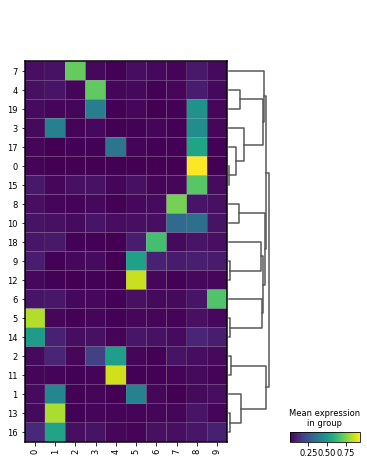

In [26]:
sc.pl.matrixplot(lda_adata, var_names=lda_adata.var.index, groupby='LDA_kmeans_cluster', dendrogram=True)

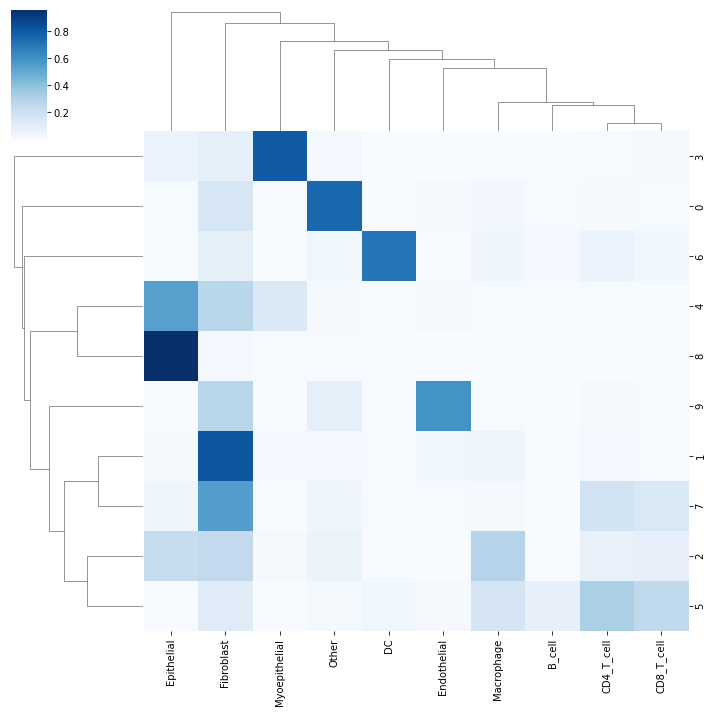

In [28]:
topic_df = pd.DataFrame(data=model.get_topics(), columns=[dictionary.get(i) for i in range(len(dictionary))],
                        index=np.arange(num_topics))
import seaborn as sns
sns.clustermap(topic_df, cmap='Blues')

In [33]:
metacluster_to_cluster = {
    'Tumor - Pure': [0, 15],
    'Tumor - Infiltrating TAM': [7],
    'Tumor - Infiltrating Stroma': [3, 17, 2, 11],
    'Tumor - Infiltrating T cell': [10],
    'Myoepithelium': [4, 19],
    'Endothelial': [6],
    'Fibroblast': [13, 16],
    'Immune - T cell': [8],
    'Mixed Stroma': [1],
    'Immune - Mixed': [9, 12],
    'Immune - DC': [18],
    'Noise': [5, 14]
}
cluster_to_metacluster = {str(v):k for k, vs in metacluster_to_cluster.items() for v in vs}
sorted(cluster_to_metacluster.items())

[('0', 'Tumor - Pure'),
 ('1', 'Mixed Stroma'),
 ('10', 'Tumor - Infiltrating T cell'),
 ('11', 'Tumor - Infiltrating Stroma'),
 ('12', 'Immune - Mixed'),
 ('13', 'Fibroblast'),
 ('14', 'Noise'),
 ('15', 'Tumor - Pure'),
 ('16', 'Fibroblast'),
 ('17', 'Tumor - Infiltrating Stroma'),
 ('18', 'Immune - DC'),
 ('19', 'Myoepithelium'),
 ('2', 'Tumor - Infiltrating Stroma'),
 ('3', 'Tumor - Infiltrating Stroma'),
 ('4', 'Myoepithelium'),
 ('5', 'Noise'),
 ('6', 'Endothelial'),
 ('7', 'Tumor - Infiltrating TAM'),
 ('8', 'Immune - T cell'),
 ('9', 'Immune - Mixed')]

In [35]:
cell_to_kmeans = {c:str(k) for c, k in zip(cells, kmeans.labels_)}
cell_to_metacluster = {c:cluster_to_metacluster[cell_to_kmeans[c]]
                      for c in cells}
for s, a in sample_to_adata.items():
    f = df.loc[a.obs.index.to_list()]
    a.obsm['X_lda'] = f.values
    a.obs['LDA_kmeans_cluster'] = [cell_to_kmeans[c] for c in a.obs.index.to_list()]
    a.obs['metacluster'] = [cell_to_metacluster[c] for c in a.obs.index.to_list()]

In [23]:
plt.rcParams["figure.figsize"] = (8, 8)
plt.rcParams["figure.dpi"] = 120

In [32]:
a.uns['metacluster_colors']

array(['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b',
       '#e377c2', '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', '#98df8a'],
      dtype=object)

In [72]:
def show_cluster(adata, cluster, cluster_col='metacluster', radius=300):
    r1, r2, c1, c2 = get_ideal_window(
        adata, radius=radius, cell_type=cluster, cell_type_col=cluster_col,
        return_filtered=False)
    sc.pl.spatial(adata, color=cluster_col, crop_coord=[c1, c2, r1, r2], size=1.)
    return r1, r2, c1, c2
    
def display_on_img(adata, img, cluster, cluster_col='metacluster', radius=300, show_all=False,
                  pallete=sns.color_palette('tab20'), s=5, edgecolors='black', ax=None, legend=True,
                  pallete_map=None):
    f, (r1, r2, c1, c2) = get_ideal_window(
        adata, radius=radius, cell_type=cluster, cell_type_col=cluster_col,
        return_filtered=True)
    
    if ax is None:
        fig, ax = plt.subplots()
    im = ax.imshow(img[r1:r2, c1:c2])
    
    if show_all:
        f = adata[((adata.obs['centroid_row']>r1)&(adata.obs['centroid_row']<r2))]
        f = f[((f.obs['centroid_col']>c1)&(f.obs['centroid_col']<c2))]
        
        for ct, color in zip(sorted(set(f.obs[cluster_col])), pallete):
            fx = f[f.obs[cluster_col]==ct]
            if pallete_map is not None:
                color = pallete_map[ct]
            ax.scatter(fx.obs['centroid_col'] - c1, fx.obs['centroid_row'] - r1, c=color, label=ct, s=s,
                      edgecolors=edgecolors)
            
        if legend:
            ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    else:
        ax.scatter(f.obs['centroid_col'] - c1, f.obs['centroid_row'] - r1, c='red', s=s,
                  edgecolors=edgecolors)
    return r1, r2, c1, c2

In [19]:
s = 'HT206B1-H1'
a = sample_to_adata[s]
a.shape

(221081, 14)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

(10184, 12184, 848, 2848)

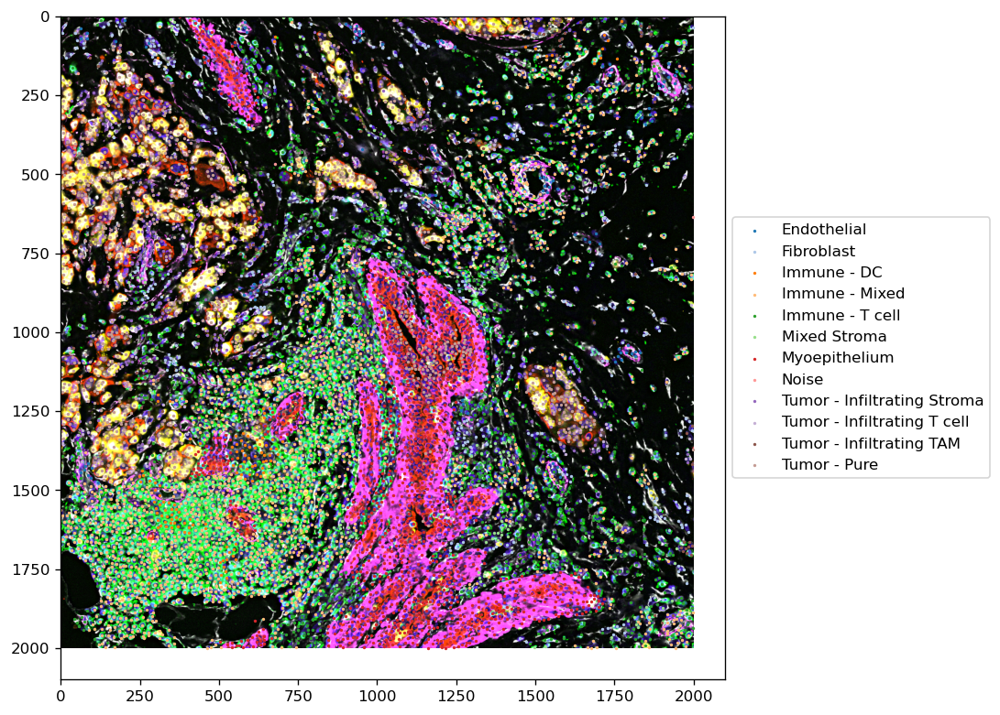

In [59]:
display_on_img(a, sample_to_pseudo[s], 'Tumor - Infiltrating T cell', cluster_col='metacluster', radius=1000,
               show_all=True, s=1, edgecolors=None)

HT206B1-H1


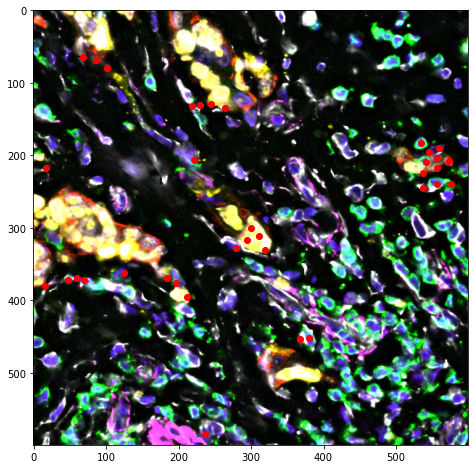

HT323B1-H1A1


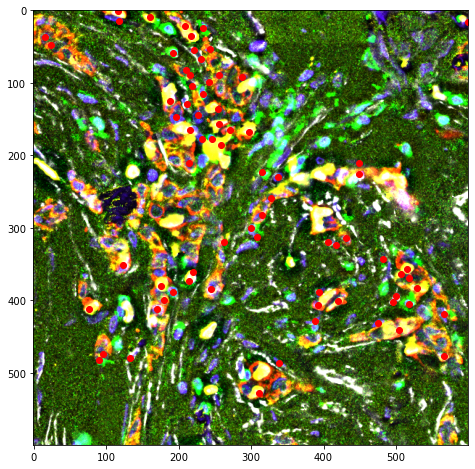

HT323B1-H1A4


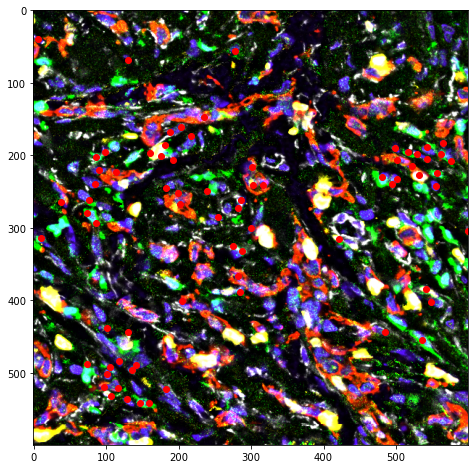

HT323B1-H3


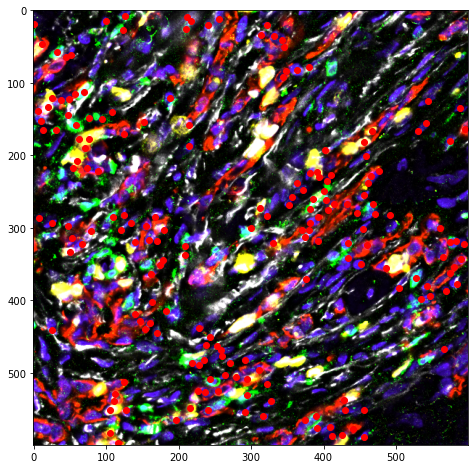

HT339B1-H1A1


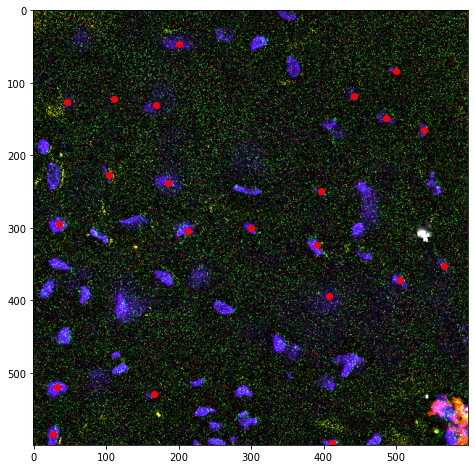

HT339B1-H2A1


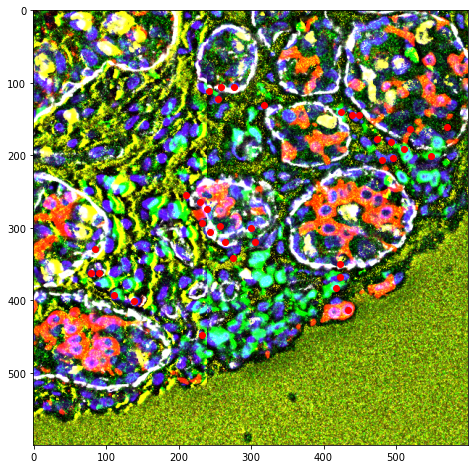

HT339B1-H4A4


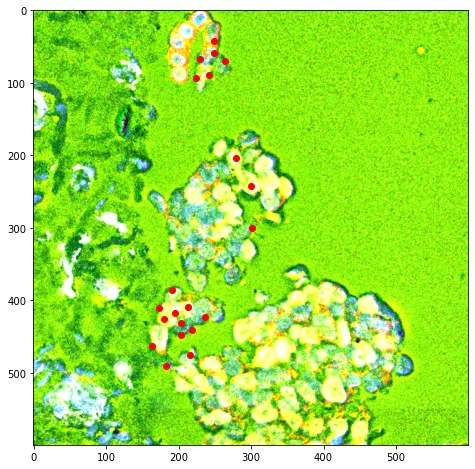

HT397B1-H2A2


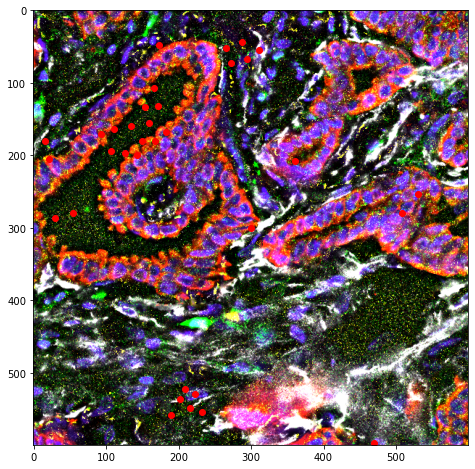

HT397B1-H3A1


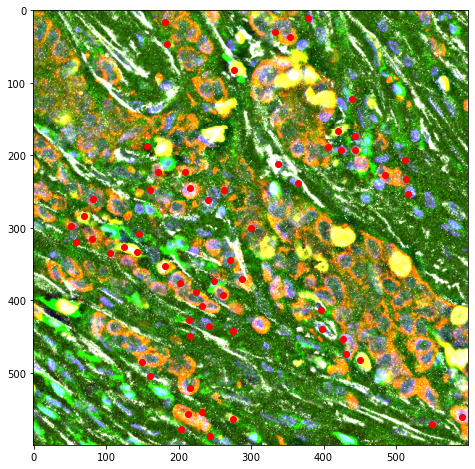

In [63]:
for s, a in sample_to_adata.items():
    print(s)
    display_on_img(a, sample_to_pseudo[s], metacluster, cluster_col='metacluster', radius=300)
    
    plt.show()

HT206B1-H1
HT323B1-H1A1
HT323B1-H1A4
HT323B1-H3
HT339B1-H1A1
HT339B1-H2A1
HT339B1-H4A4
HT397B1-H2A2
HT397B1-H3A1


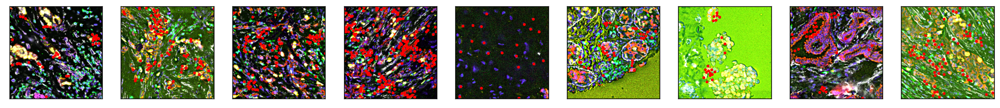

In [79]:
metacluster = 'Tumor - Infiltrating T cell'

fig, axs = plt.subplots(ncols=len(sample_to_adata), figsize=(20, 5))
m = {}
for s, a in sample_to_adata.items():
    m.update({ct:c for ct, c in zip(sorted(set(a.obs['metacluster'])), sns.color_palette('tab20'))})
for i, (s, a) in enumerate(sample_to_adata.items()):
    print(s)
    ax = axs[i]
    display_on_img(a, sample_to_pseudo[s], metacluster, cluster_col='metacluster', radius=300, show_all=False,
                   s=5, ax=ax, edgecolors=None)
    ax.set_xticks([])
    ax.set_yticks([])
plt.show()

HT206B1-H1
HT323B1-H1A1
HT323B1-H1A4
HT323B1-H3
HT339B1-H1A1
HT339B1-H2A1
HT339B1-H4A4
HT397B1-H2A2
HT397B1-H3A1


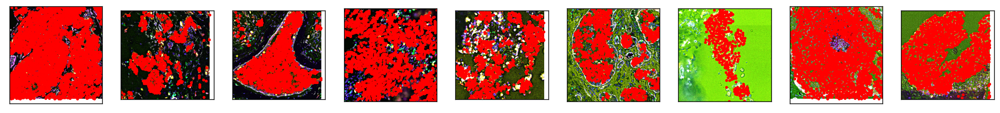

In [81]:
metacluster = 'Tumor - Pure'

fig, axs = plt.subplots(ncols=len(sample_to_adata), figsize=(20, 5))
m = {}
for s, a in sample_to_adata.items():
    m.update({ct:c for ct, c in zip(sorted(set(a.obs['metacluster'])), sns.color_palette('tab20'))})
for i, (s, a) in enumerate(sample_to_adata.items()):
    print(s)
    ax = axs[i]
    display_on_img(a, sample_to_pseudo[s], metacluster, cluster_col='metacluster', radius=500, show_all=False,
                   s=5, ax=ax, edgecolors=None)
    ax.set_xticks([])
    ax.set_yticks([])
plt.show()

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

HT206B1-H1


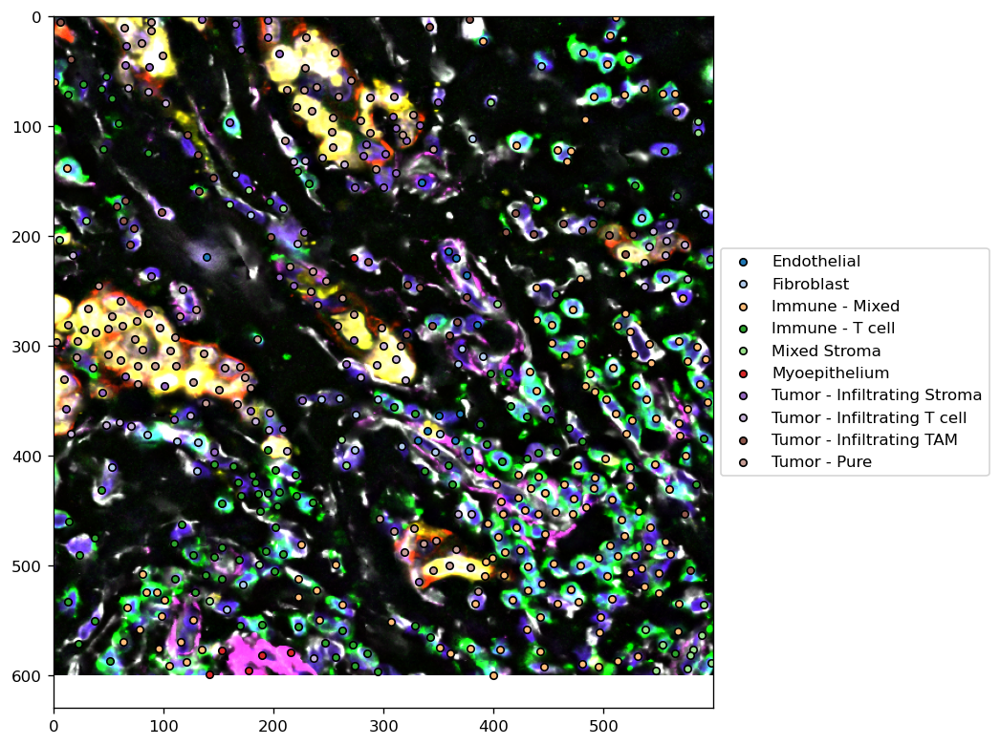

HT323B1-H1A1


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

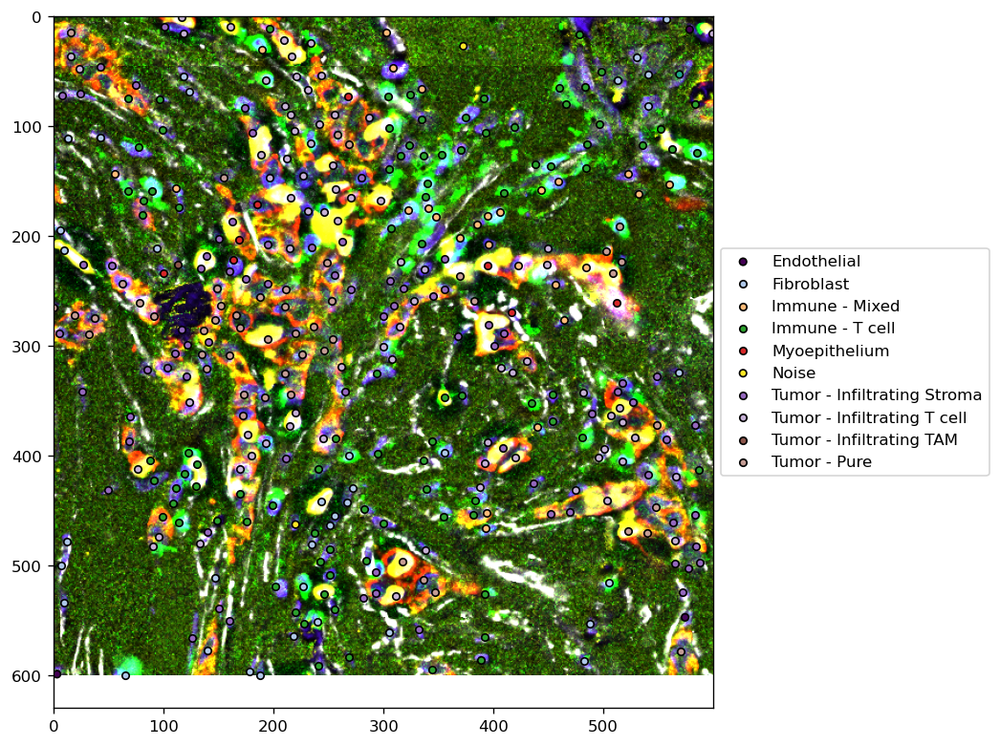

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

HT323B1-H1A4


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

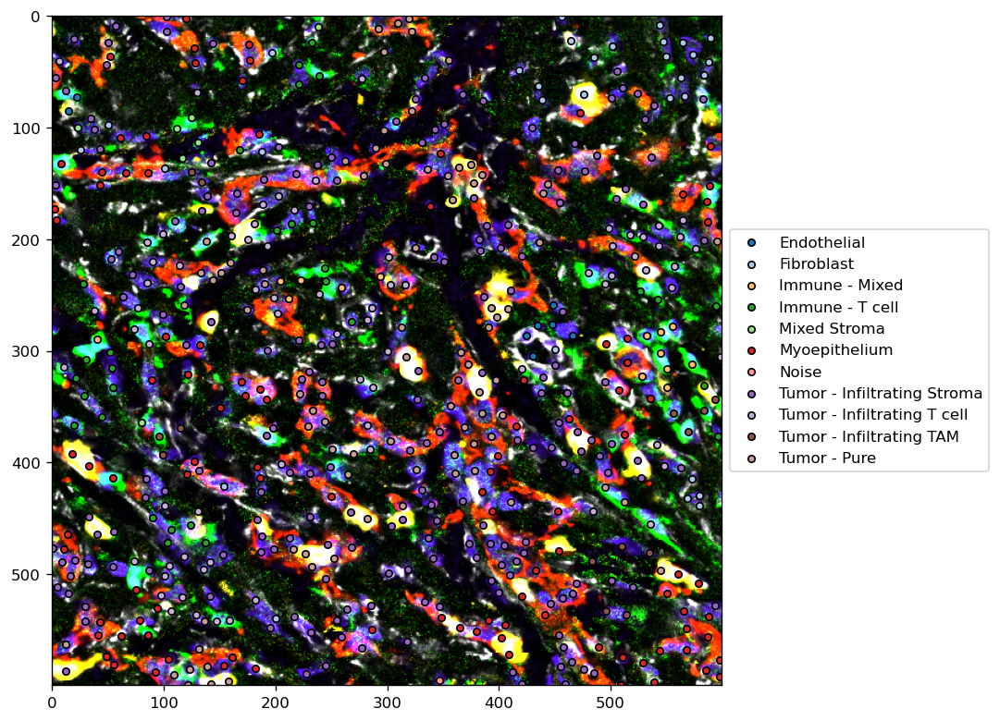

HT323B1-H3


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

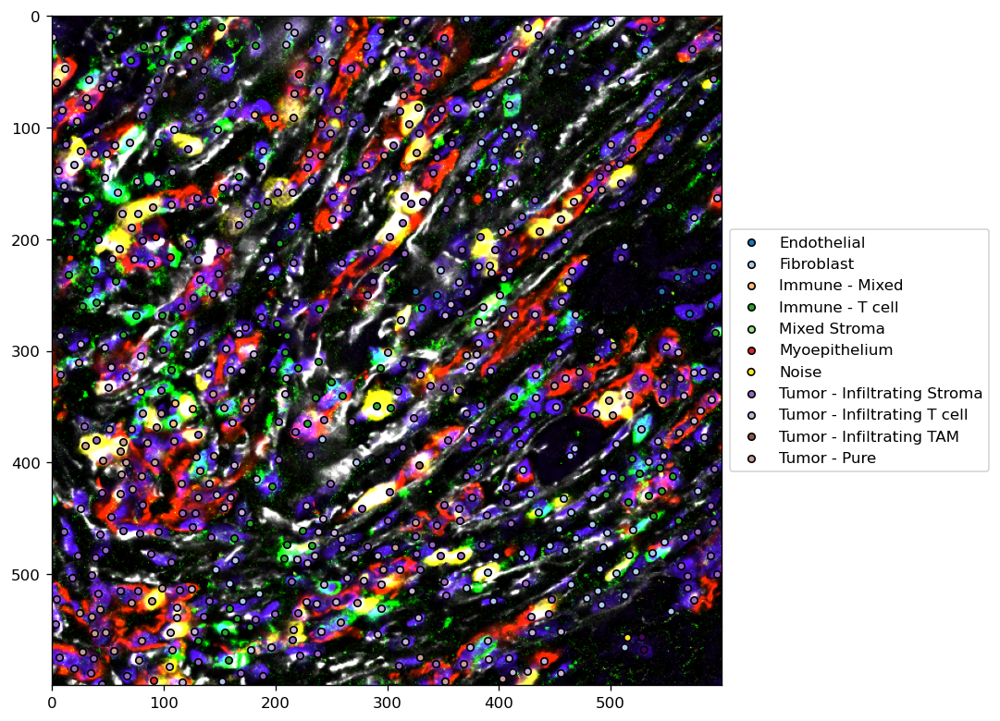

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

HT339B1-H1A1


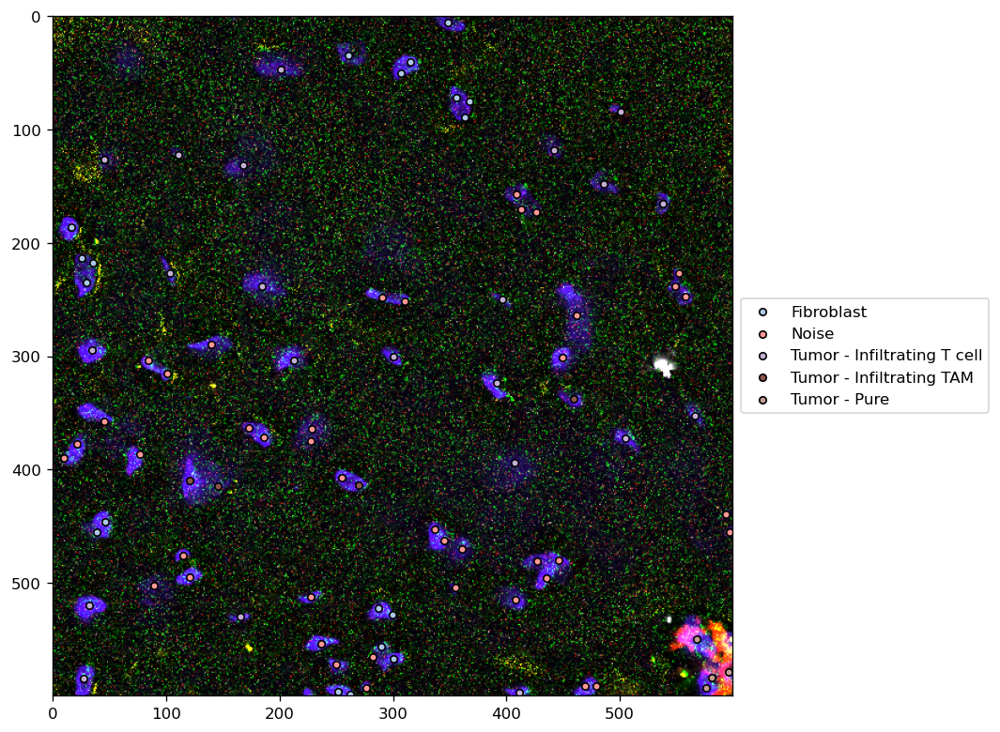

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

HT339B1-H2A1


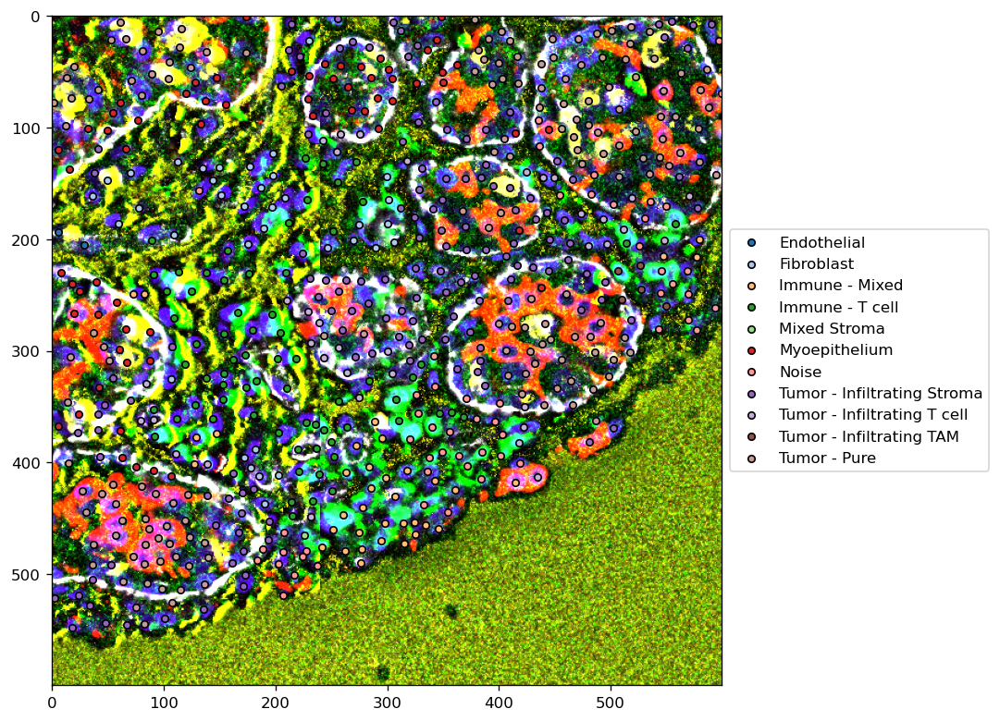

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

HT339B1-H4A4


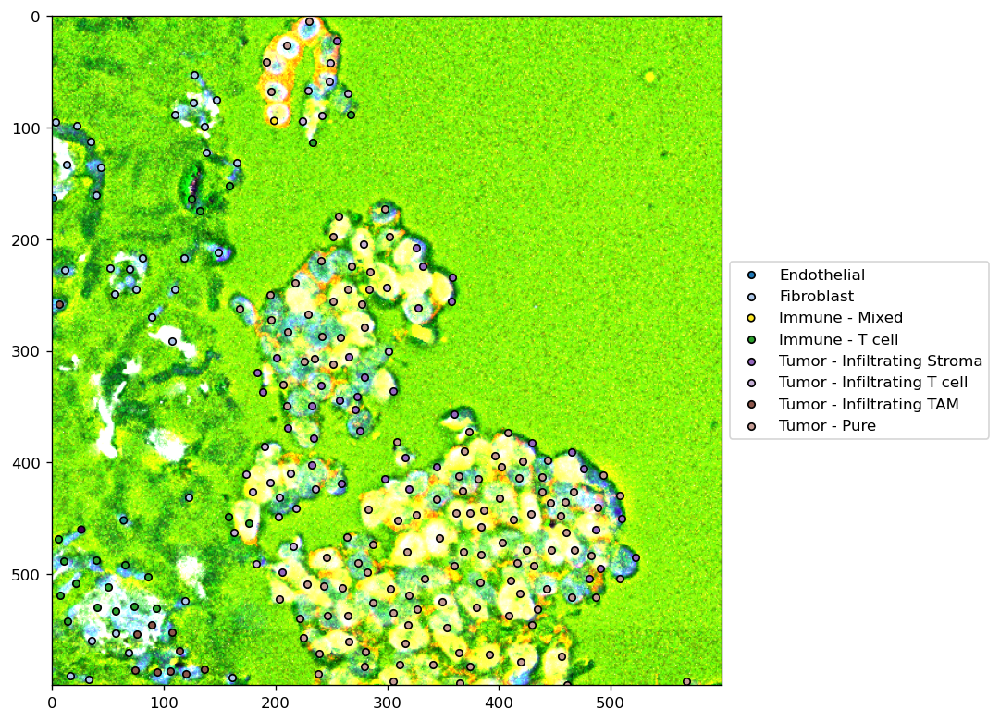

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

HT397B1-H2A2


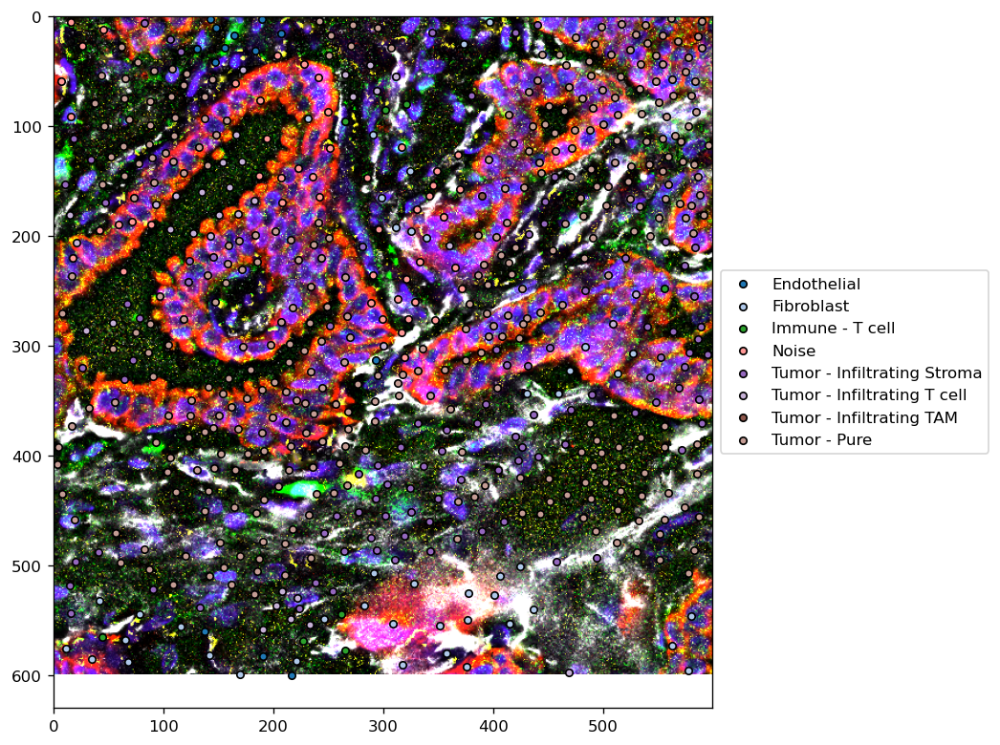

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


HT397B1-H3A1


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

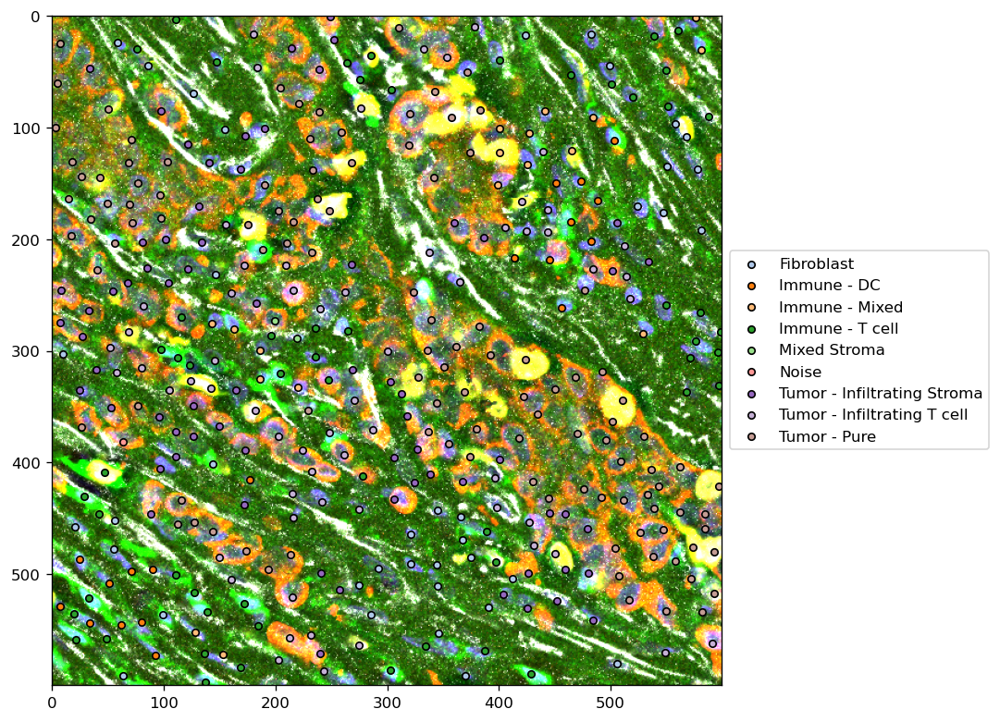

In [76]:
metacluster = 'Tumor - Infiltrating T cell'
for s, a in sample_to_adata.items():
    print(s)
    display_on_img(a, sample_to_pseudo[s], metacluster, cluster_col='metacluster', radius=300, show_all=True,
                   s=20, pallete_map=m)
    plt.show()

HT206B1-H1


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

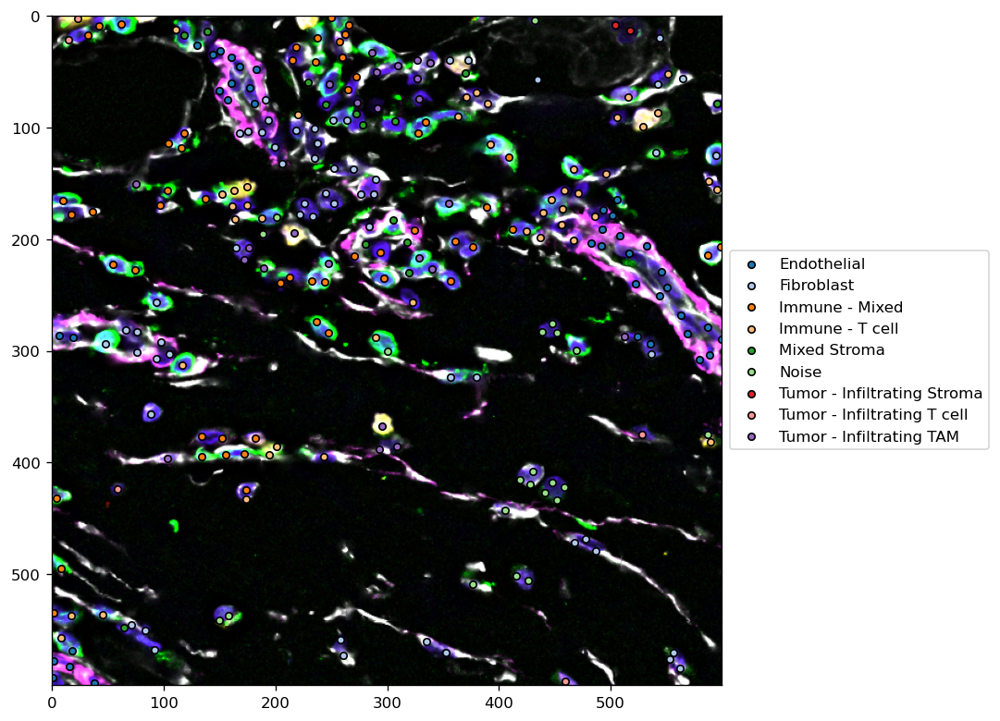

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


HT323B1-H1A1


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

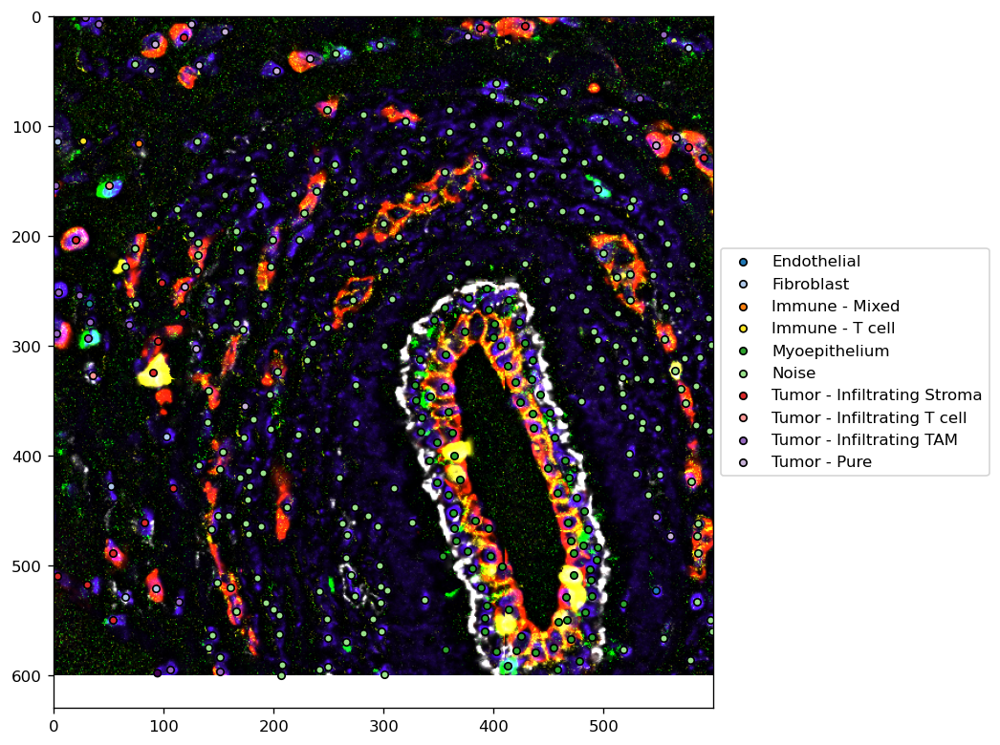

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


HT323B1-H1A4


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

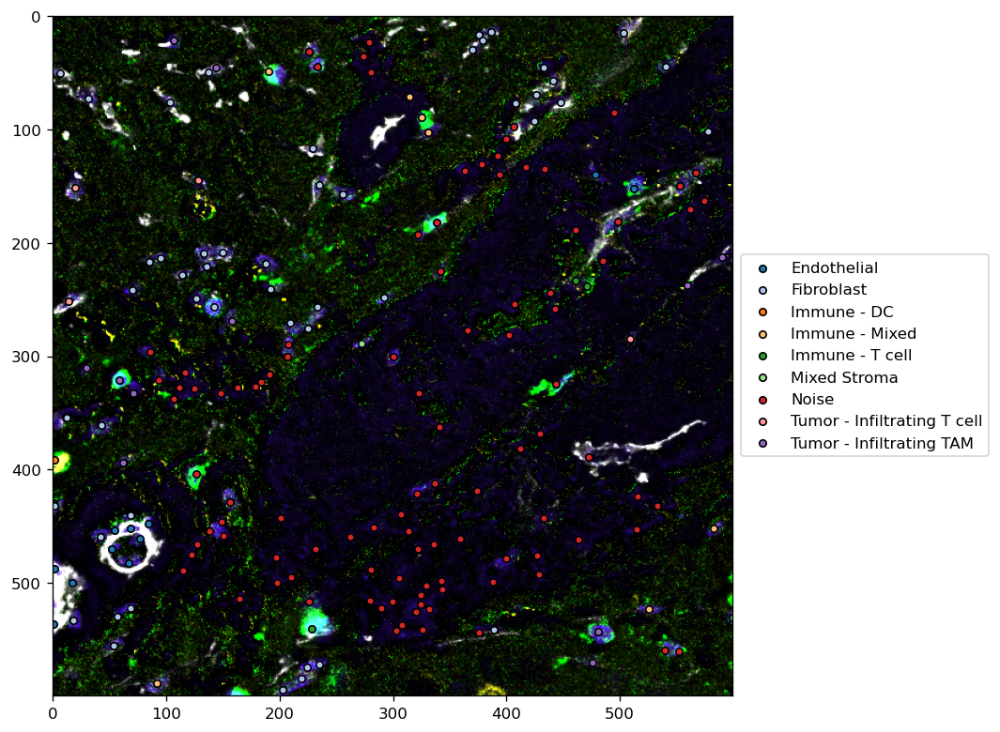

HT323B1-H3


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

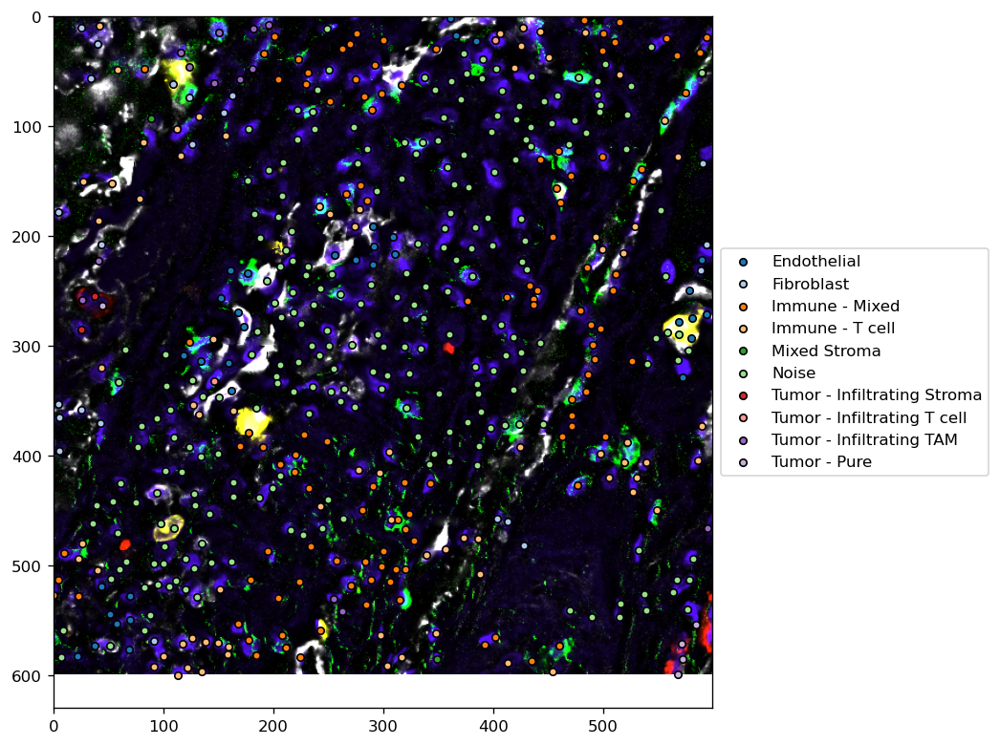

HT339B1-H1A1


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

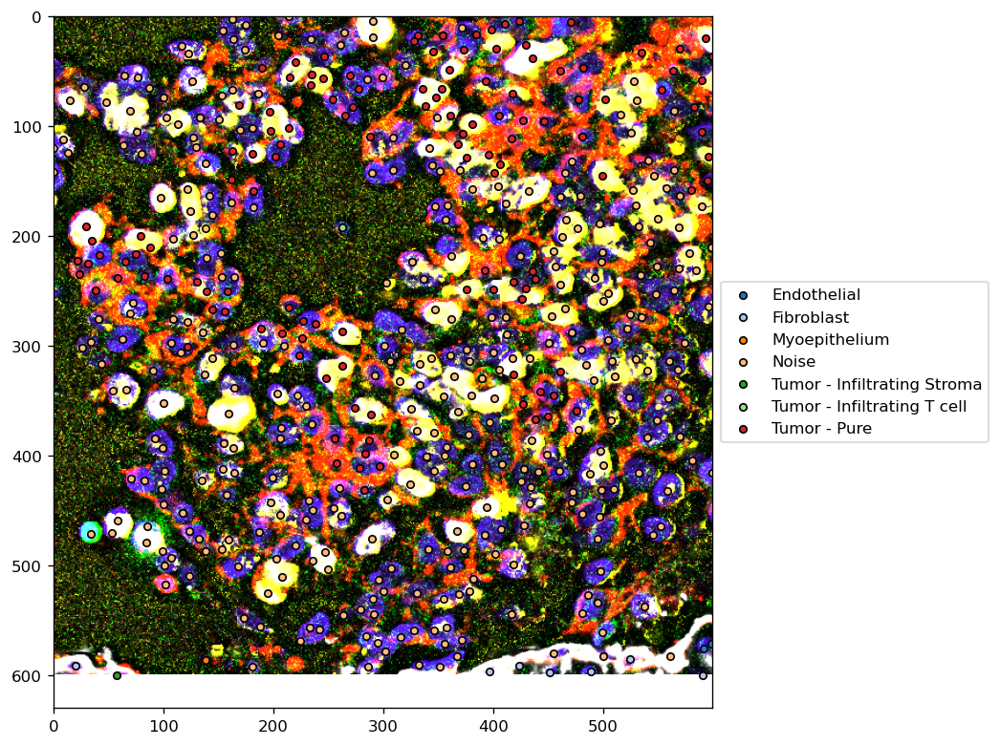

HT339B1-H2A1


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

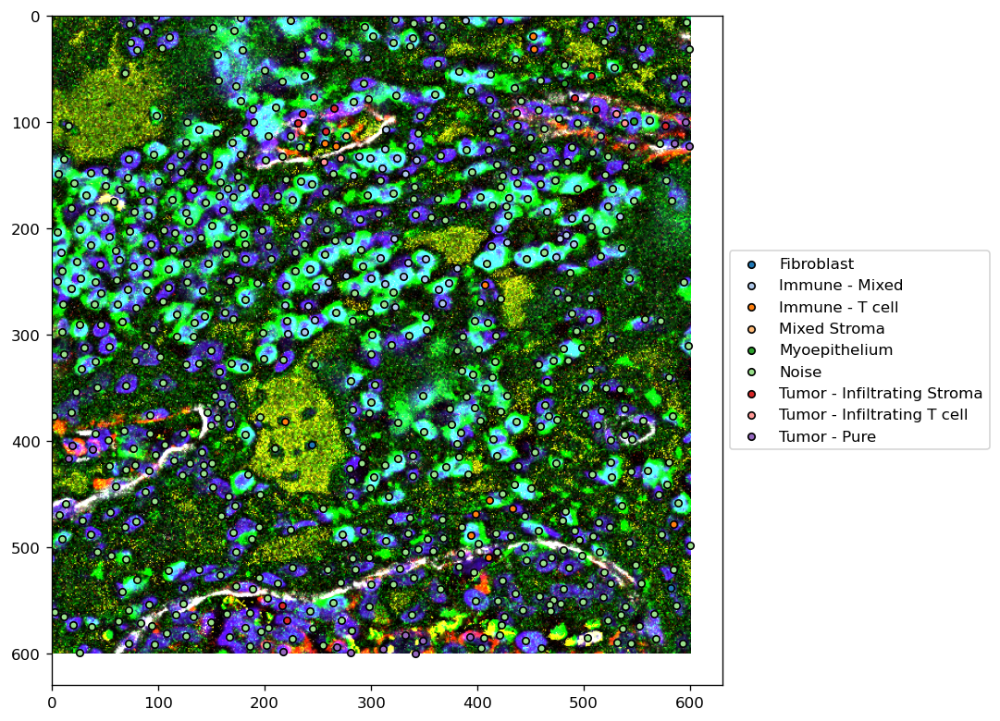

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

HT339B1-H4A4


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

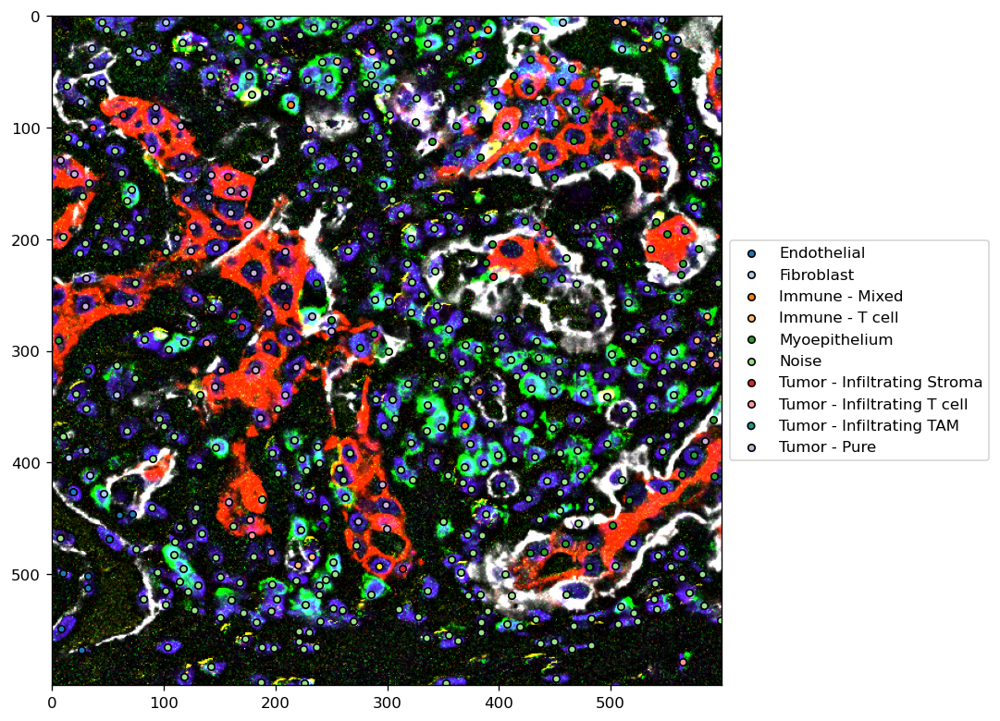

HT397B1-H2A2


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

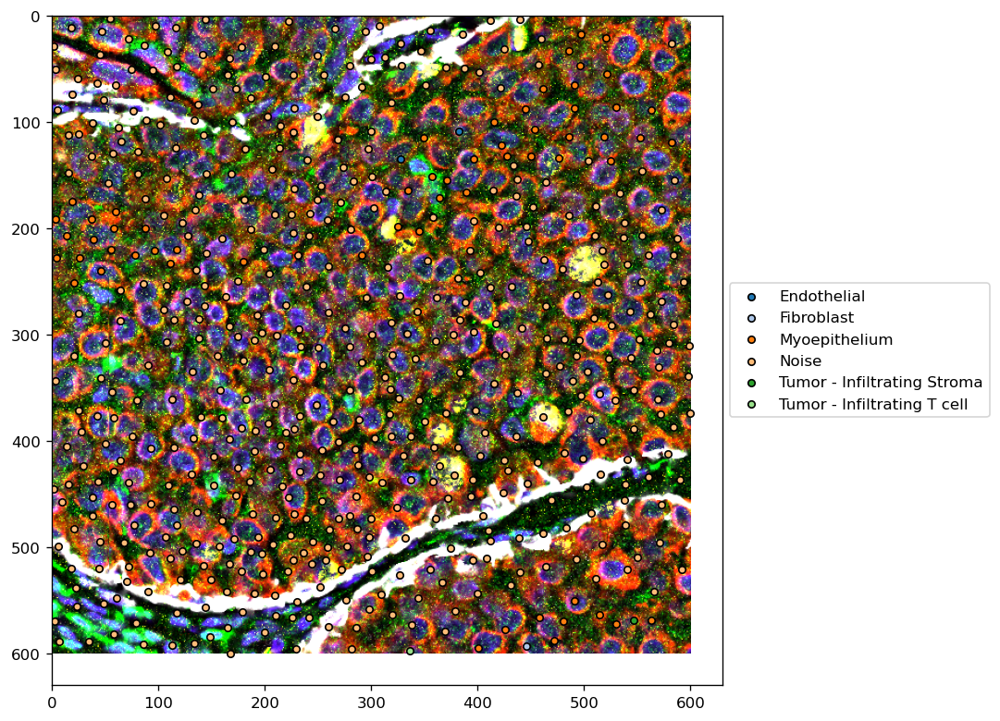

HT397B1-H3A1


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

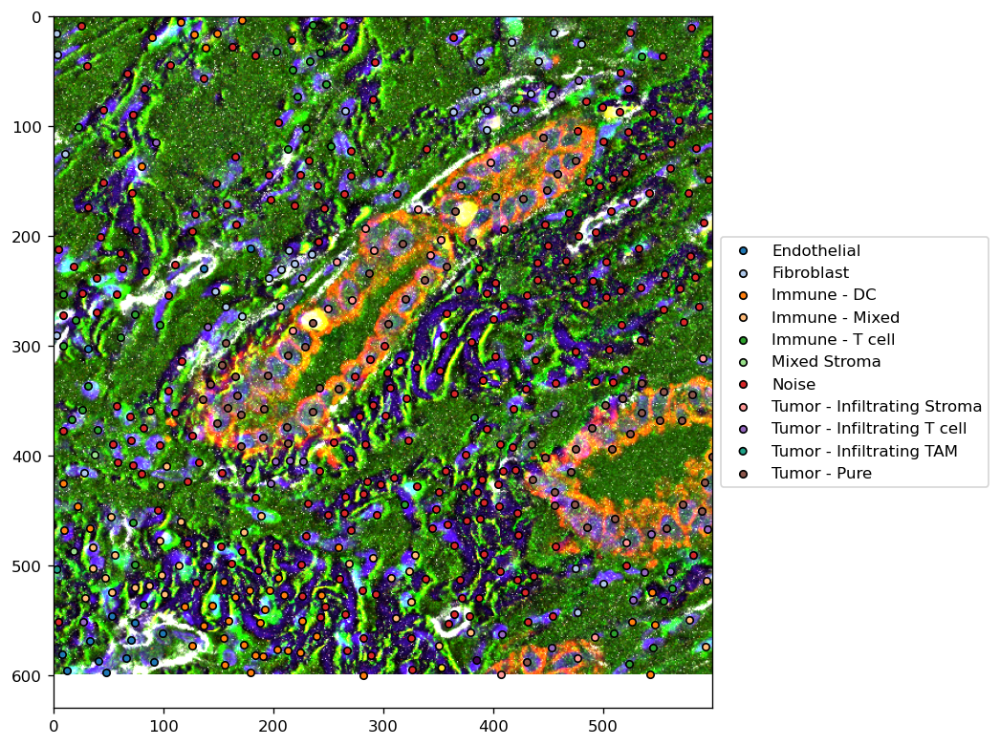

In [62]:
metacluster = 'Noise'
for s, a in sample_to_adata.items():
    print(s)
    display_on_img(a, sample_to_pseudo[s], metacluster, cluster_col='metacluster', radius=300, show_all=True,
                   s=20)
    plt.show()

In [65]:
for s, a in sample_to_adata.items():
    fp = f'/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/{s}/level_4/metacluster_lda.h5ad'
    a.write_h5ad(fp)

In [74]:
from collections import Counter
data, idxs = [], []
cols = sorted(set(cell_to_metacluster.values()))
for s, a in sample_to_adata.items():
    counts = Counter(a.obs['metacluster'])
    data.append([counts.get(c, 0) for c in cols])
    idxs.append(s)
df = pd.DataFrame(data=data, index=idxs, columns=cols)
df

,Endothelial,Fibroblast,Immune - DC,Immune - Mixed,Immune - T cell,Mixed Stroma,Myoepithelium,Noise,Tumor - Infiltrating Stroma,Tumor - Infiltrating T cell,Tumor - Infiltrating TAM,Tumor - Pure
HT206B1-H1,6378,17416,1206,31769,11308,5305,7365,815,12002,2184,12335,112998
HT323B1-H1A1,3620,13908,19,7053,8914,771,11042,6455,12146,4833,4119,12472
HT323B1-H1A4,5493,21374,523,6110,7295,1218,21687,3183,28872,4341,7363,32666
HT323B1-H3,7436,35029,2,17792,33996,4662,14864,4933,45797,19110,17742,67332
HT339B1-H1A1,4233,10820,0,552,1264,233,4460,8399,1603,1425,1689,3925
HT339B1-H2A1,9924,13578,0,650,1028,208,16850,29713,2678,1780,1464,6232
HT339B1-H4A4,1545,3743,0,2226,1424,185,4781,2940,279,894,294,1122
HT397B1-H2A2,12347,14494,9064,2231,1315,167,9840,21033,9285,2617,817,69170
HT397B1-H3A1,6742,33063,23803,28065,17035,1979,2557,12456,22388,7015,3337,87356


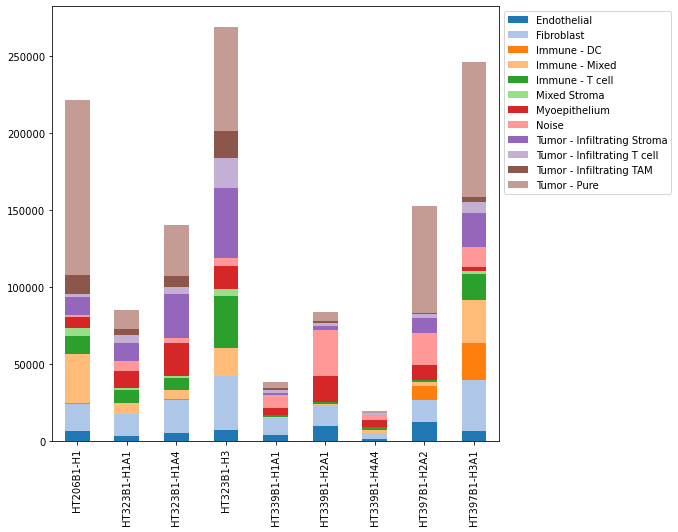

In [91]:
ax = df.plot(kind='bar', stacked=True, color=sns.color_palette('tab20'))
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

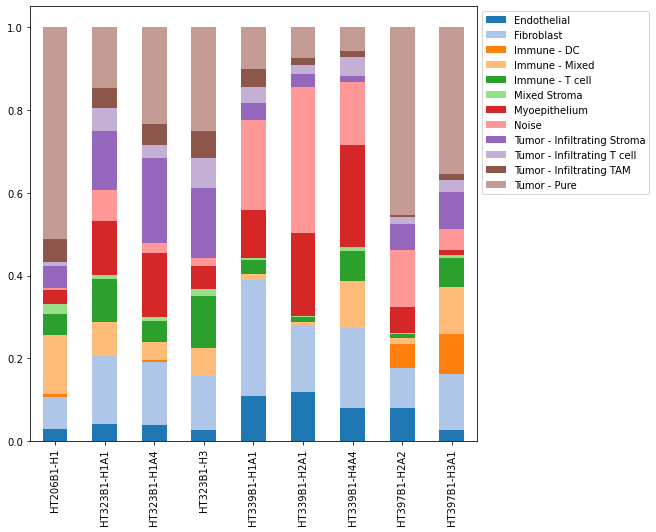

In [100]:
ax = (df / df.sum(axis=1).values.reshape(-1, 1)).plot(kind='bar', stacked=True, color=sns.color_palette('tab20'))
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

In [103]:
data, idxs = [], []
cols = sorted(set(a.obs['cell_type']))
for s, a in sample_to_adata.items():
    counts = Counter(a.obs['cell_type'])
    data.append([counts.get(c, 0) for c in cols])
    idxs.append(s)
df = pd.DataFrame(data=data, index=idxs, columns=cols)
df

,B_cell,CD4_T_cell,CD8_T_cell,DC,Endothelial,Epithelial,Fibroblast,Macrophage,Myoepithelial,Other
HT206B1-H1,2693,16853,10229,3226,6827,115860,40086,14218,6361,4728
HT323B1-H1A1,218,5290,5138,39,2936,23906,28311,3404,8635,7475
HT323B1-H1A4,219,4866,4176,1409,4675,54366,40483,6518,17106,6307
HT323B1-H3,1226,19002,15511,91,7964,101642,82843,14038,14203,12175
HT339B1-H1A1,26,751,411,0,3068,5753,14659,2108,3196,8631
HT339B1-H2A1,416,887,545,0,6766,11562,22809,2543,11252,27325
HT339B1-H4A4,17,172,3074,0,1236,1920,6033,566,3689,2726
HT397B1-H2A2,770,1523,1205,9356,8758,75387,25645,1568,7484,20684
HT397B1-H3A1,4972,15536,10734,22675,6805,99877,59715,5331,2823,17328


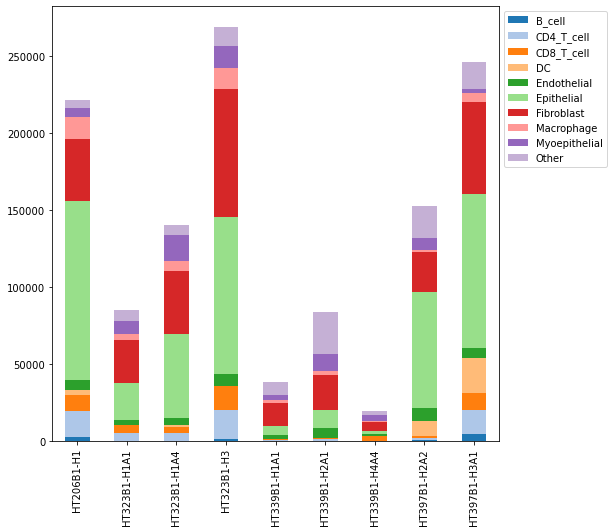

In [104]:
ax = df.plot(kind='bar', stacked=True, color=sns.color_palette('tab20'))
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

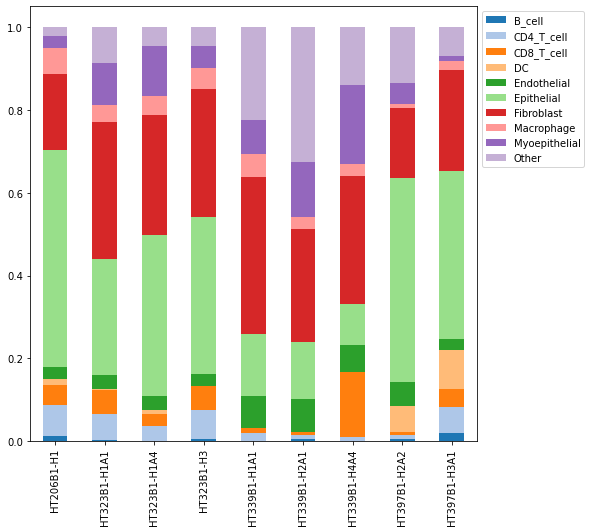

In [105]:
ax = (df / df.sum(axis=1).values.reshape(-1, 1)).plot(kind='bar', stacked=True, color=sns.color_palette('tab20'))
ax.legend(loc='upper left', bbox_to_anchor=(1, 1))

In [67]:
sq.gr.spatial_neighbors(a, key_added='spatial')

In [68]:
sq.gr.interaction_matrix(a, cluster_key="metacluster")

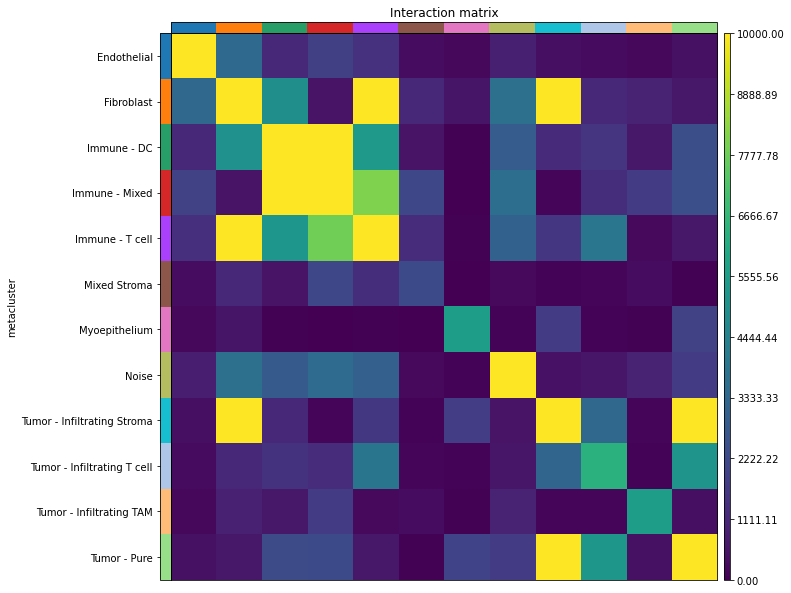

In [72]:
sq.pl.interaction_matrix(a, cluster_key="metacluster", vmax=10000)

In [106]:
sq.gr.co_occurrence(a, cluster_key="metacluster", n_splits=1, n_jobs=40,
                    interval=[50, 100, 200, 500, 1000])

  0%|          | 0/1 [00:00<?, ?/s]

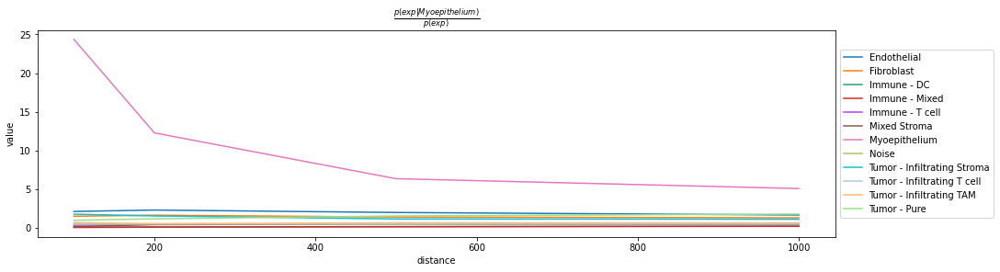

In [107]:
sq.pl.co_occurrence(
    a,
    cluster_key="metacluster",
    clusters=["Myoepithelium"],
    figsize=(15, 4),
)

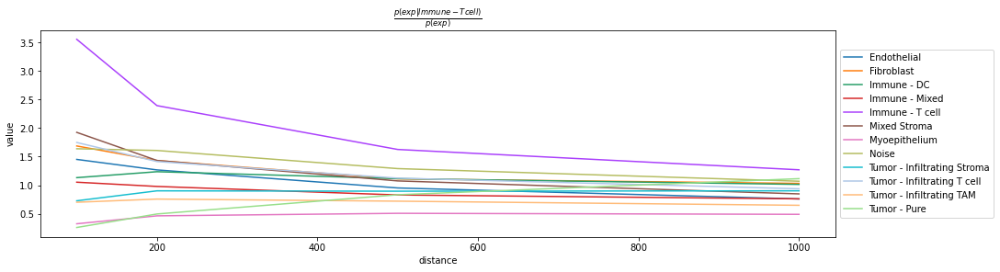

In [108]:
sq.pl.co_occurrence(
    a,
    cluster_key="metacluster",
    clusters=["Immune - T cell"],
    figsize=(15, 4),
)

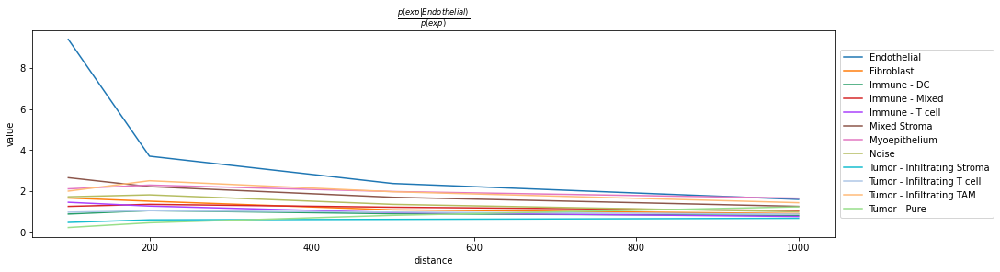

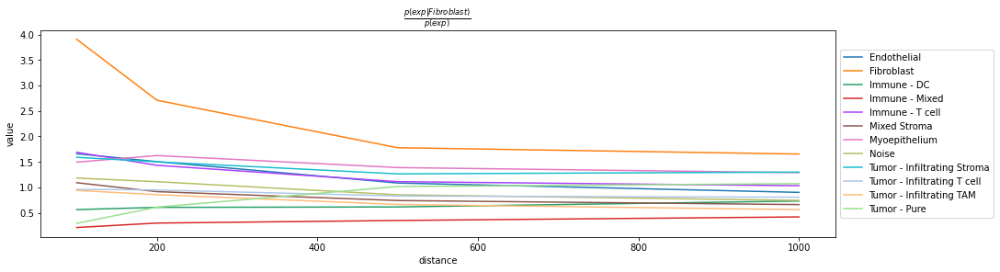

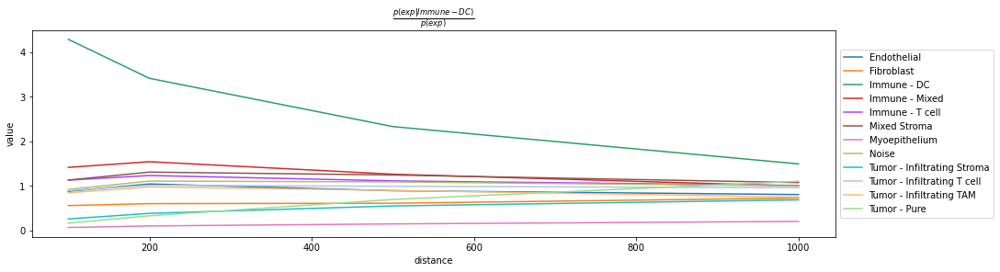

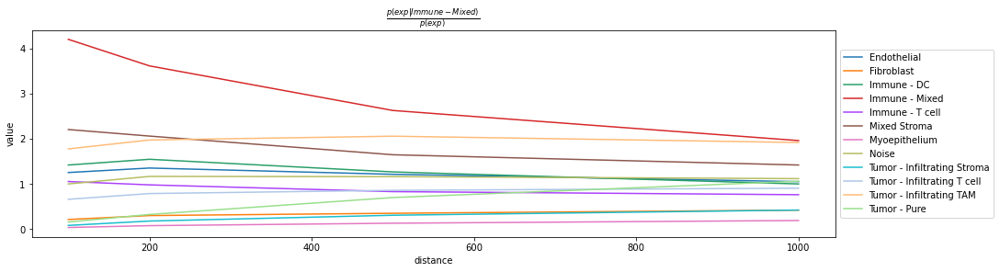

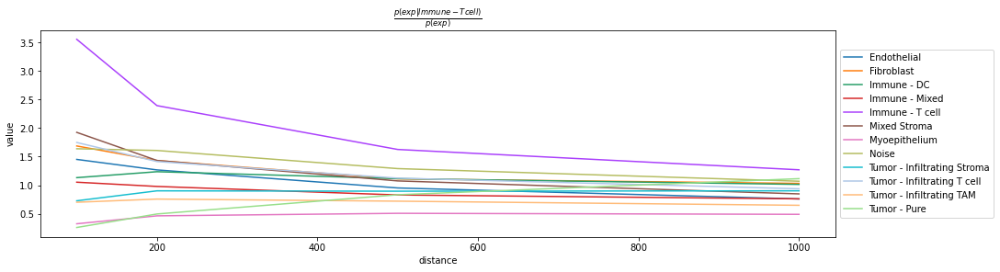

...

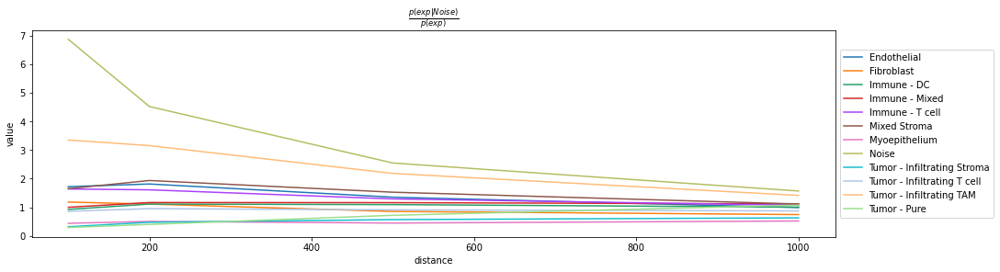

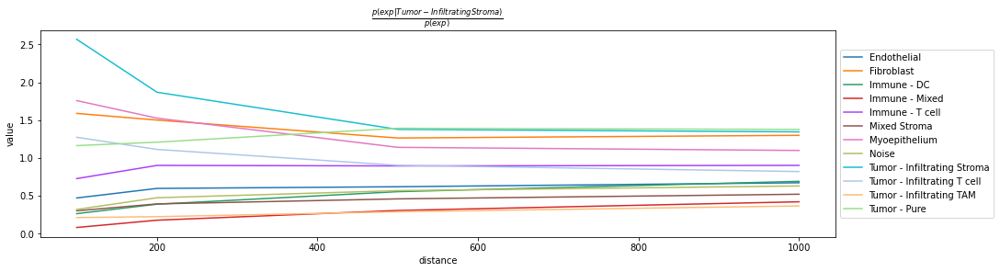

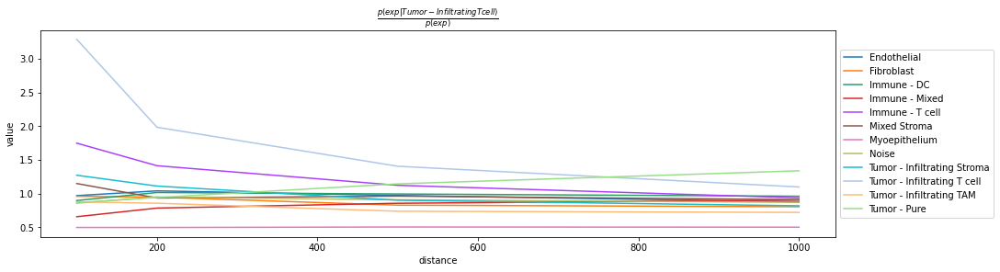

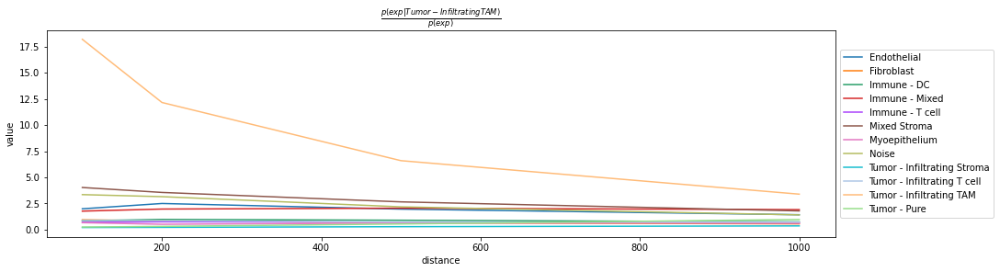

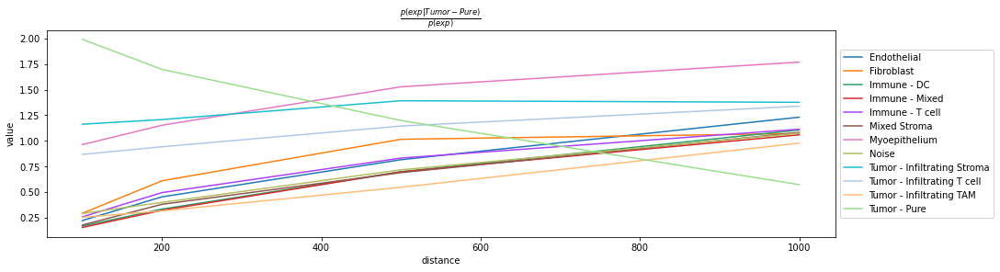

In [112]:
for c in sorted(set(a.obs['metacluster'])):
    sq.pl.co_occurrence(
        a,
        cluster_key="metacluster",
        clusters=[c],
#         dpi=220
        figsize=(15, 4),
    )

In [16]:
fps = sorted(listfiles('/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/', regex=r'metacluster_lda.h5ad$'))
fps

['/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT206B1-H1/level_4/metacluster_lda.h5ad',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT323B1-H1A1/level_4/metacluster_lda.h5ad',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT323B1-H1A4/level_4/metacluster_lda.h5ad',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT323B1-H3/level_4/metacluster_lda.h5ad',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT339B1-H1A1/level_4/metacluster_lda.h5ad',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT339B1-H2A1/level_4/metacluster_lda.h5ad',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT339B1-H4A4/level_4/metacluster_lda.h5ad',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT397B1-H2A2/level_4/metacluster_lda.h5ad',
 '/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/HT397B1-H3A1/level_4/metacluster_lda.h5ad']

In [17]:
sample_to_adata = {fp.split('/')[-3]:sc.read_h5ad(fp) for fp in fps}

In [82]:
for s, a in sample_to_adata.items():
    print(s)
    sq.gr.spatial_neighbors(a, key_added='spatial')
    sq.gr.interaction_matrix(a, cluster_key="metacluster")
    sq.gr.co_occurrence(a, cluster_key="metacluster", n_splits=1, n_jobs=40, interval=[50, 100, 200, 500, 1000])
    sq.gr.interaction_matrix(a, cluster_key="cell_type")
    sq.gr.co_occurrence(a, cluster_key="cell_type", n_splits=1, n_jobs=40, interval=[50, 100, 200, 500, 1000])
    a.write_h5ad(f'/diskmnt/Projects/Users/estorrs/multiplex_data/codex/htan/{s}/level_4/metacluster_spatial_analysis.h5ad')
    

HT206B1-H1


  0%|          | 0/1 [00:00<?, ?/s]

  0%|          | 0/1 [00:00<?, ?/s]

HT323B1-H1A1


  0%|          | 0/1 [00:00<?, ?/s]

  0%|          | 0/1 [00:00<?, ?/s]

HT323B1-H1A4


  0%|          | 0/1 [00:00<?, ?/s]

/diskmnt/Projects/Users/estorrs/miniconda3/envs/squidpy/lib/python3.7/site-packages/skimage/io/manage_plugins.py:23: UserWarning: Your installed pillow version is < 8.1.2. Several security issues (CVE-2021-27921, CVE-2021-25290, CVE-2021-25291, CVE-2021-25293, and more) have been fixed in pillow 8.1.2 or higher. We recommend to upgrade this library.
  from .collection import imread_collection_wrapper


  0%|          | 0/1 [00:00<?, ?/s]

HT323B1-H3


  0%|          | 0/1 [00:00<?, ?/s]

MemoryError: Unable to allocate 53.8 GiB for an array with shape (84967, 84967) and data type float64